In [1]:
import os

import wandb
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import pandas as pd
from egg.palettes import palettes
import scipy.stats as st

In [2]:
from torchmetrics.image import StructuralSimilarityIndexMeasure

In [3]:
class WandbRun:
    def __init__(self, run_id):
        self.run_id = run_id
        self.api = wandb.Api()
        self.run = self.api.run(f"sinzlab/egg/{run_id}")

    def history(self):
        return self.run.history()

    def get_image(self, data):
        try:
            filename = data.image["path"]
            file = self.run.file(filename)
            filename = file.download(exist_ok=True).name
            image = Image.open(filename)
            image = np.array(image)
        except:
            image = np.zeros((100, 100))

        return image

In [4]:
def imshow(image, ax=None):
    if ax is None:
        ax = plt.gca()

    ax.imshow(image, cmap="gray", vmin=-2, vmax=2)
    ax.axis("off")

In [19]:
gt_images = np.load("../data/75_monkey_test_imgs.npy")
run = WandbRun("dumwlquk")
run_gd = WandbRun("3nmju72v")
history = run.history()
history_gd = run_gd.history()

In [6]:
import torch
import torchvision

mask = np.load('../data/full_mask.npy')
mask_100 = torchvision.transforms.Resize((100, 100))(torch.Tensor(mask).unsqueeze(0).unsqueeze(0)).squeeze().numpy()

# mask_100[mask_100 < 0.5] = 0

def mask_image(image, mask):
    return image * mask[None, :, :]

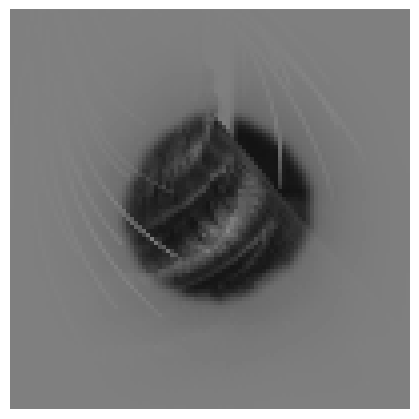

In [7]:
plt.figure(figsize=(4, 4))
imshow(mask_image(gt_images[14], mask_100).squeeze())
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
plt.savefig("gt_recon_6.png", dpi=150, pad_inches=0)

In [78]:
import torch.nn.functional as F
import torch

import torch
import torchvision

# import weights=VGG16_Weights.DEFAULT
from torchvision.models.vgg import VGG16_Weights

class VGGPerceptualLoss(torch.nn.Module):
    def __init__(self, resize=True):
        super(VGGPerceptualLoss, self).__init__()
        blocks = []
        blocks.append(torchvision.models.vgg16(weights=VGG16_Weights.DEFAULT).features[:4].eval())
        blocks.append(torchvision.models.vgg16(weights=VGG16_Weights.DEFAULT).features[4:9].eval())
        blocks.append(torchvision.models.vgg16(weights=VGG16_Weights.DEFAULT).features[9:16].eval())
        blocks.append(torchvision.models.vgg16(weights=VGG16_Weights.DEFAULT).features[16:23].eval())
        for bl in blocks:
            for p in bl.parameters():
                p.requires_grad = False
        self.blocks = torch.nn.ModuleList(blocks)
        self.transform = torch.nn.functional.interpolate
        self.resize = resize
        self.register_buffer("mean", torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1))
        self.register_buffer("std", torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1))

    def forward(self, input, target, feature_layers=[0, 1, 2, 3], style_layers=[]):
        if input.shape[1] != 3:
            input = input.repeat(1, 3, 1, 1)
            target = target.repeat(1, 3, 1, 1)
        # input = (input-self.mean) / self.std
        # target = (target-self.mean) / self.std
        if self.resize:
            input = self.transform(input, mode='bilinear', size=(224, 224), align_corners=False)
            target = self.transform(target, mode='bilinear', size=(224, 224), align_corners=False)
        loss = 0.0
        x = input
        y = target
        for i, block in enumerate(self.blocks):
            x = block(x)
            y = block(y)
            if i in feature_layers:
                loss += torch.nn.functional.l1_loss(x, y)
            if i in style_layers:
                act_x = x.reshape(x.shape[0], x.shape[1], -1)
                act_y = y.reshape(y.shape[0], y.shape[1], -1)
                gram_x = act_x @ act_x.permute(0, 2, 1)
                gram_y = act_y @ act_y.permute(0, 2, 1)
                loss += torch.nn.functional.l1_loss(gram_x, gram_y)
        return loss

ssim = StructuralSimilarityIndexMeasure()
vgg = VGGPerceptualLoss()
l1_loss = torch.nn.MSELoss()

result = {
    'ssim': {
        'gd': [],
        'egg': []
    },
    'vgg': {
        'gd': [],
        'egg': []
    },
}

import os

np.random.seed(0)
switch = np.random.uniform(size=50) > 0.5
print(switch)

# os.mkdir("results/recons")
for i in range(50):
    gt = torch.Tensor(gt_images[i].squeeze()).unsqueeze(0).unsqueeze(0)
    pred = torch.Tensor(run.get_image(history.iloc[i])[..., 0].squeeze())
    pred_gd = torch.Tensor(run_gd.get_image(history_gd.iloc[i]).squeeze()).unsqueeze(0).unsqueeze(0)

    pred = F.interpolate(
        pred.unsqueeze(0).unsqueeze(0), size=(100, 100), mode="bilinear", align_corners=False
    )

    pred = (pred - pred.mean()) / pred.std() * gt.std() + gt.mean()
    pred_gd = (pred_gd - pred_gd.mean()) / pred_gd.std() * gt.std() + gt.mean()

    gt = mask_image(gt, mask_100)
    pred = mask_image(pred, mask_100)
    pred_gd = mask_image(pred_gd, mask_100)

    # normalize to the same mean and std as gt


    # normalize to [-2, 2]
    # gt = (gt - gt.min()) / (gt.max() - gt.min()) * 2 - 1
    # pred = (pred - pred.min()) / (pred.max() - pred.min()) * 2 - 1
    # pred_gd = (pred_gd - pred_gd.min()) / (pred_gd.max() - pred_gd.min()) * 2 - 1

    # if not os.path.exists(f"results/recons/{i}"):
    #     os.mkdir(f"results/recons/{i}")

    # fig, axs = plt.subplots(1, 3, figsize=(2.5 * 3, 2.5))
    # # plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
    # plt.margins(0, 0)
    #
    # if switch[i]:
    #     pred, pred_gd = pred_gd, pred
    #
    # imshow(pred.squeeze(), ax=axs[0])
    # imshow(gt.squeeze(), ax=axs[1])
    # imshow(pred_gd.squeeze(), ax=axs[2])
    #
    # axs[0].set_title("$\mathbf{A}$")
    # axs[2].set_title("$\mathbf{B}$")
    # plt.savefig(f"results/recons/{i}.png", dpi=150, bbox_inches='tight', pad_inches=0)
    # plt.show()

    # fig, axs = plt.subplots(1, 1, figsize=(2.5, 2.5))
    # plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
    # plt.margins(0, 0)
    # imshow(pred.squeeze(), ax=axs)
    # plt.savefig(f"results/recons/{i}/egg.png", dpi=150, pad_inches=0)
    # plt.show()
    #
    # fig, axs = plt.subplots(1, 1, figsize=(2.5, 2.5))
    # plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
    # plt.margins(0, 0)
    # imshow(pred_gd.squeeze(), ax=axs)
    # plt.savefig(f"results/recons/{i}/gd.png", dpi=150, pad_inches=0)
    # plt.show()

    # gt.min(), gt.max(), pred.min(), pred.max(), pred_gd.min(), pred_gd.max()

    l1, l2 = ssim(gt, pred), ssim(gt, pred_gd)
    result['ssim']['egg'].append(l1)
    result['ssim']['gd'].append(l2)

    l1, l2 = vgg(gt, pred), vgg(gt, pred_gd)
    result['vgg']['egg'].append(l1)
    result['vgg']['gd'].append(l2)

    #
    # print(l1, l2)

# print(np.mean(diff), np.mean(gd))

[ True  True  True  True False  True False  True  True False  True  True
  True  True False False False  True  True  True  True  True False  True
 False  True False  True  True False False  True False  True False  True
  True  True  True  True False False  True False  True  True False False
 False False]


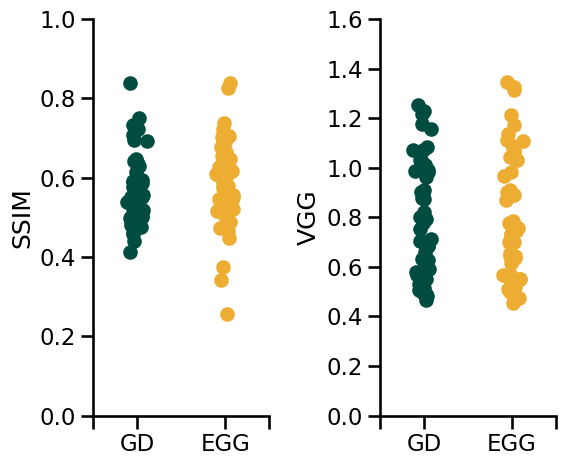

In [90]:
import seaborn as sns
from egg.palettes import palettes
plt.style.use('default')
sns.set_context('talk')
plt.figure(figsize=(6, 5))

plt.subplot(1, 2, 1)
plt.scatter(np.random.normal(loc=0, scale=0.05, size=len(result['ssim']['gd'])), result['ssim']['gd'], c=palettes["candy"]["green"])
plt.scatter(np.random.normal(loc=1, scale=0.05, size=len(result['ssim']['egg'])), result['ssim']['egg'], c=palettes["candy"]["yellow"])
plt.xticks([-0.5, 0, 1, 1.5], ["", "GD", "EGG", ""])
plt.ylabel("SSIM")

plt.ylim(0, 1)
plt.xlim(-0.5, 1.5)

plt.subplot(1, 2, 2)
plt.scatter(np.random.normal(loc=0, scale=0.05, size=len(result['vgg']['gd'])), result['vgg']['gd'], c=palettes["candy"]["green"])
plt.scatter(np.random.normal(loc=1, scale=0.05, size=len(result['vgg']['egg'])), result['vgg']['egg'], c=palettes["candy"]["yellow"])
plt.xticks([-0.5, 0, 1, 1.5], ["", "GD", "EGG", ""])
plt.ylabel("VGG")

plt.ylim(0, 1.6)
plt.xlim(-0.5, 1.5)

plt.tight_layout()
sns.despine(trim='y')
plt.savefig('./cv_metrics_recon.png', dpi=150, bbox_inches='tight', pad_inches=0)

In [24]:
import scipy.stats as stats

stats.wilcoxon(diff, gd)

WilcoxonResult(statistic=771.0, pvalue=0.0005533948133380888)

0


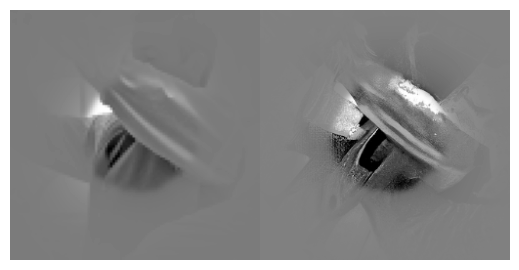

1


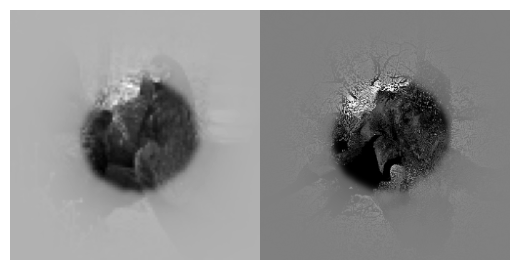

2


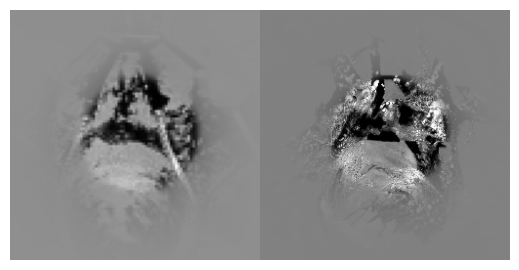

3


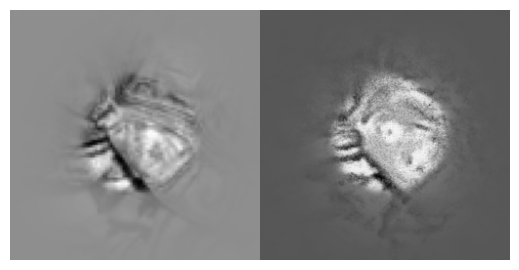

4


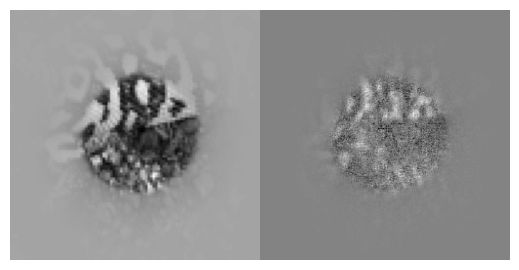

5


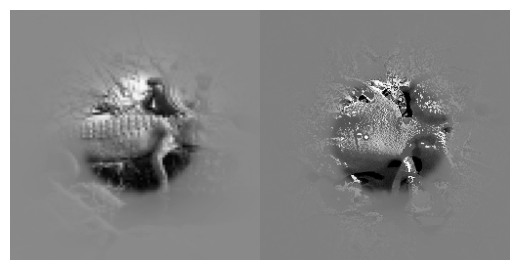

6


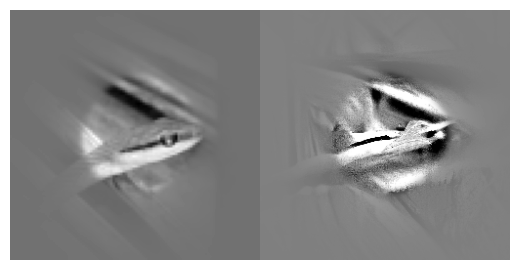

7


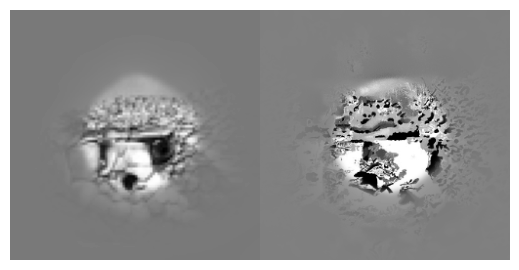

8


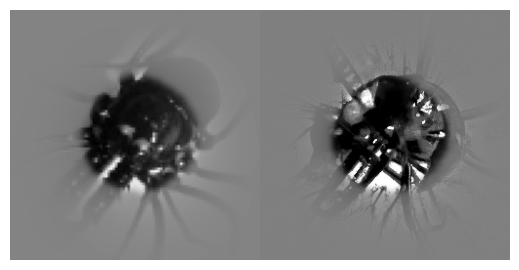

9


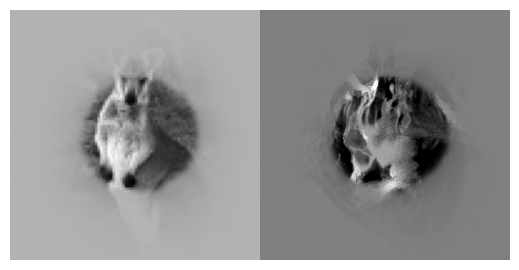

10


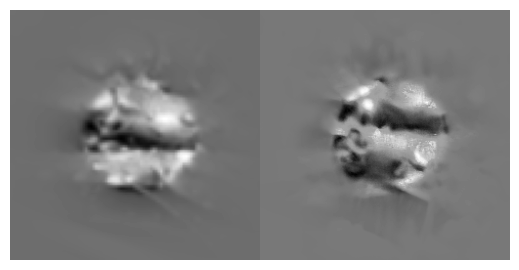

11


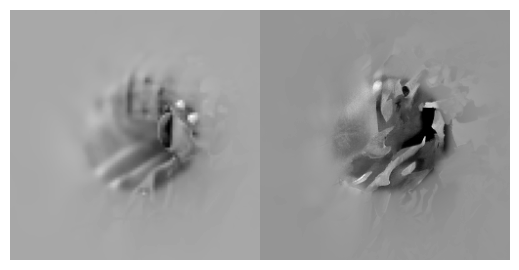

12


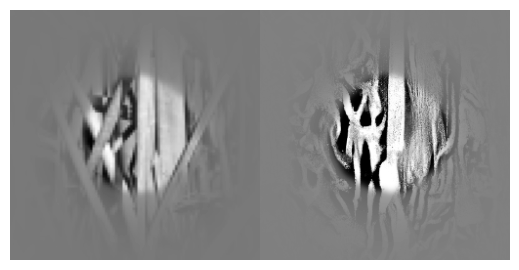

13


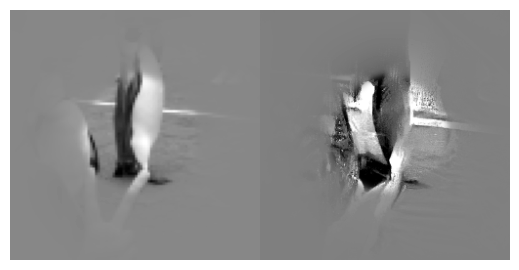

14


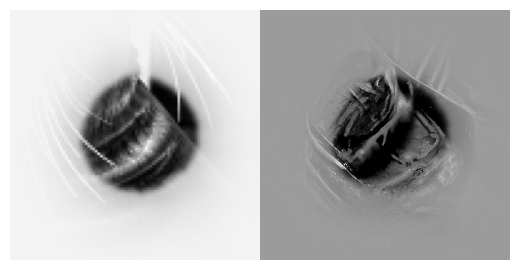

15


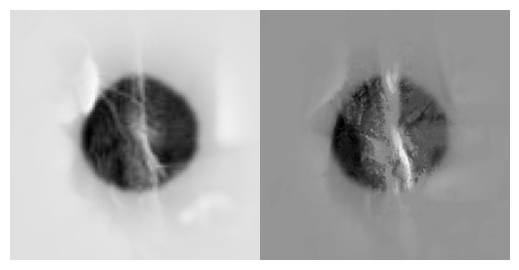

16


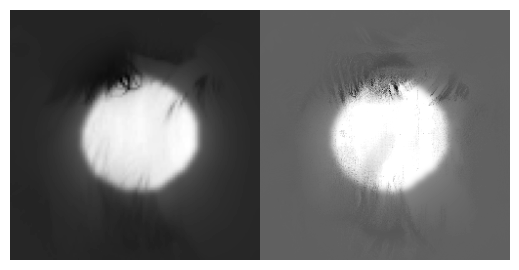

17


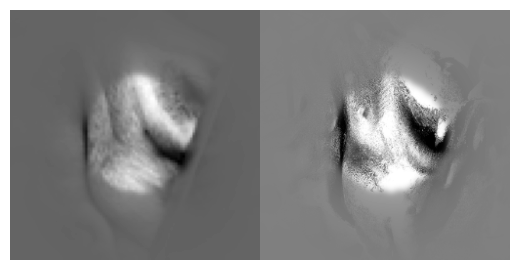

18


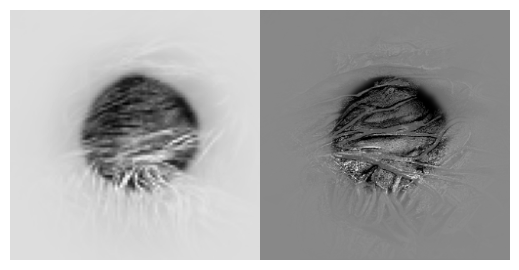

19


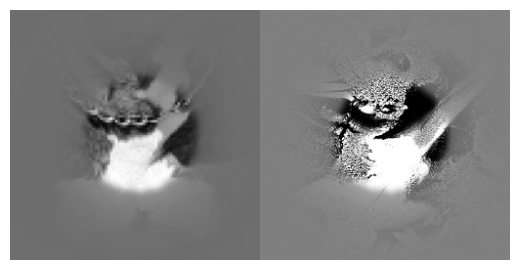

20


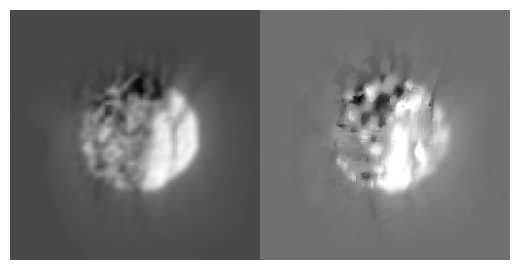

21


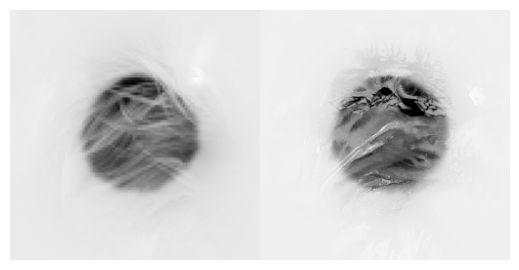

22


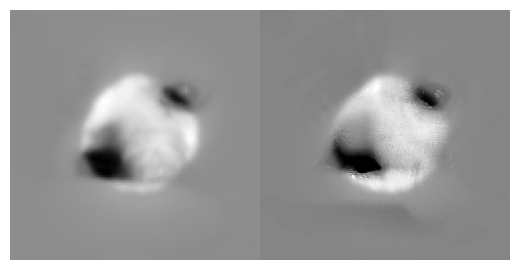

23


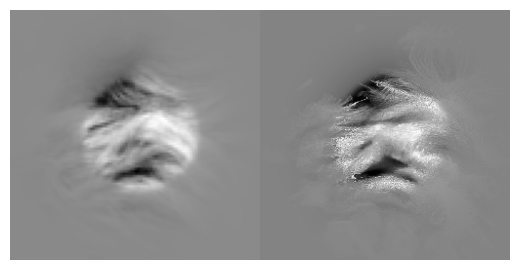

24


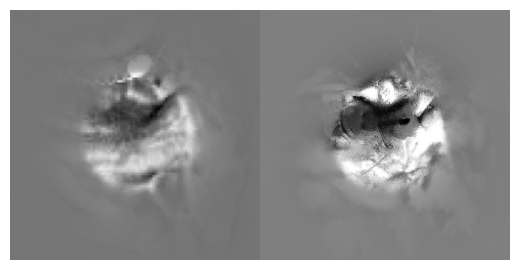

25


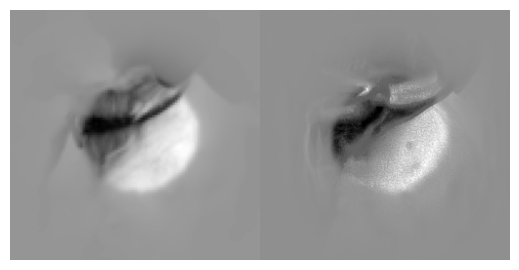

26


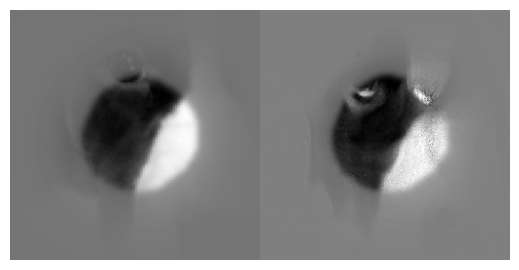

27


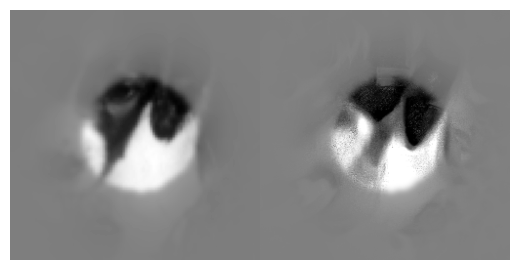

28


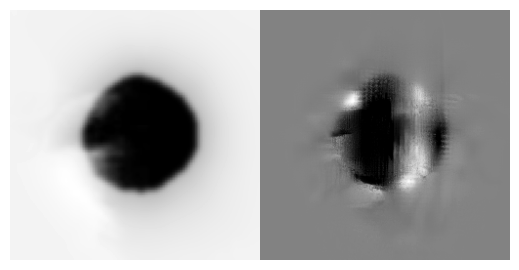

29


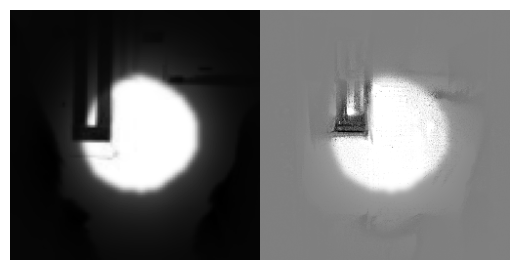

30


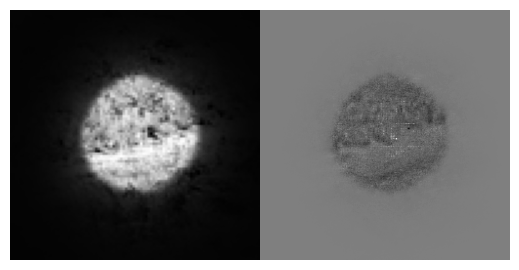

31


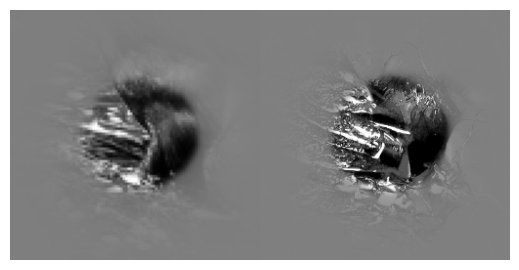

32


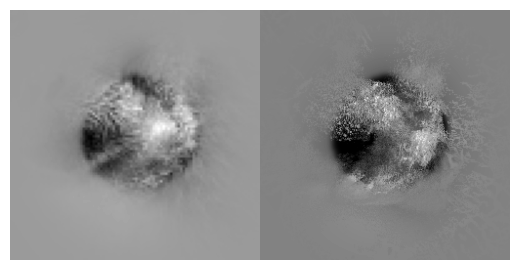

33


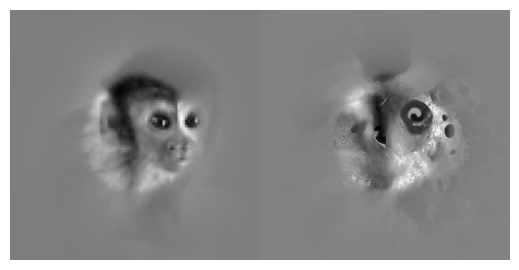

34


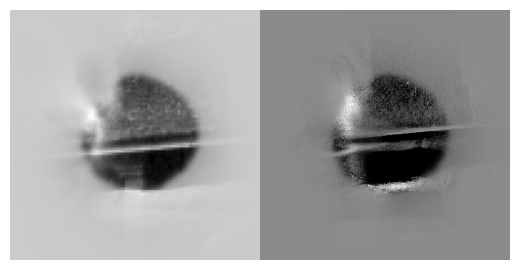

35


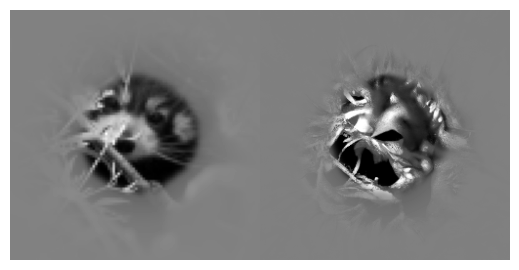

36


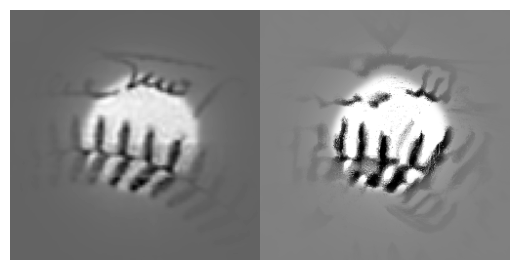

37


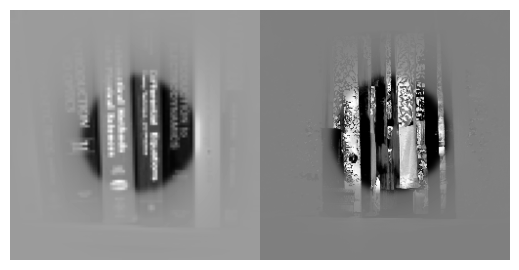

38


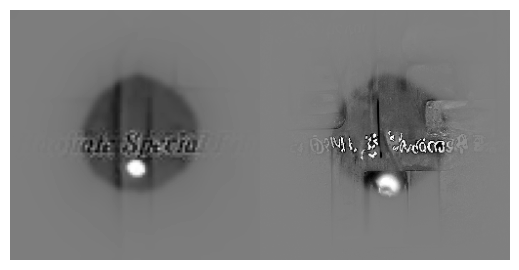

39


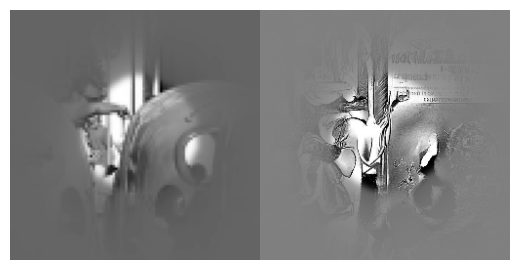

40


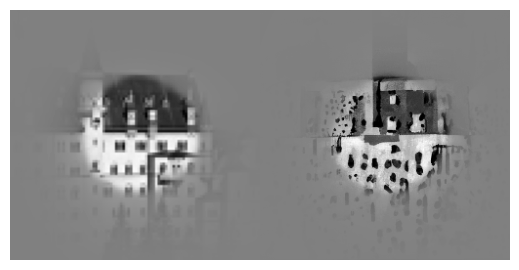

41


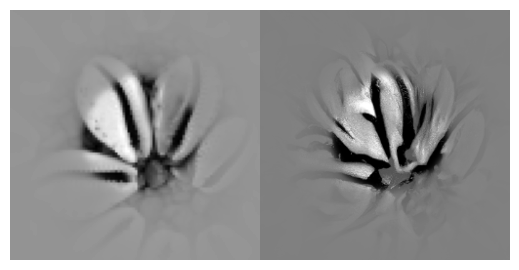

42


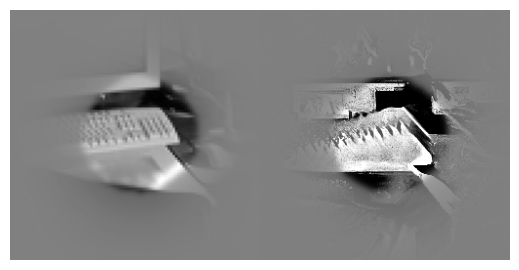

43


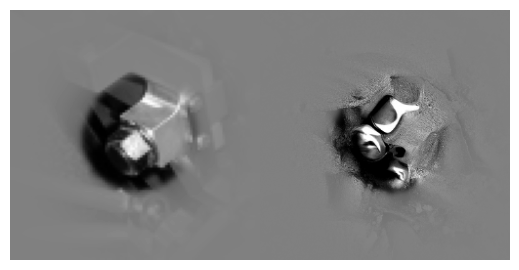

44


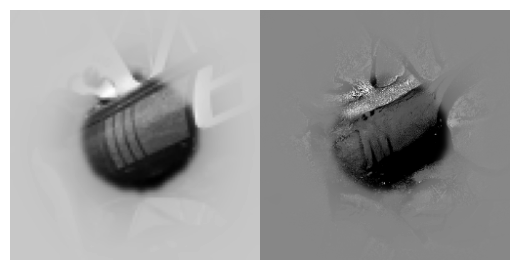

45


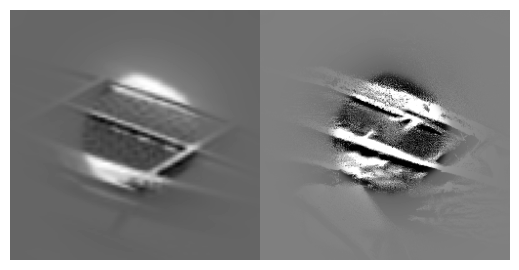

46


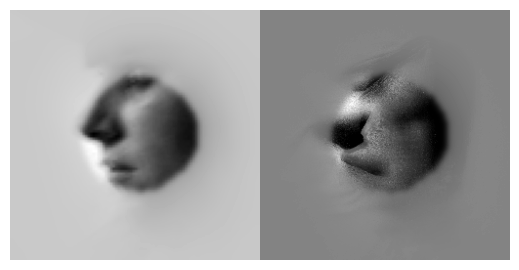

47


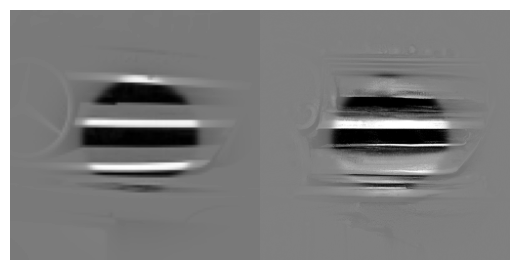

48


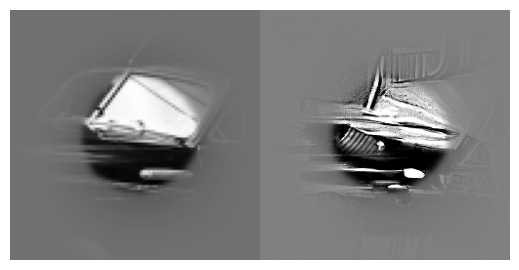

49


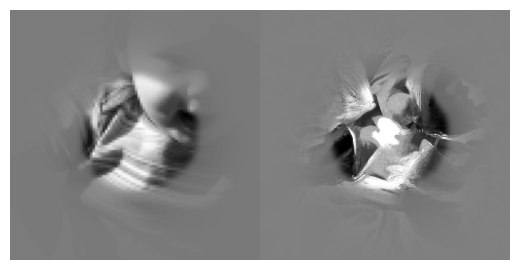

50


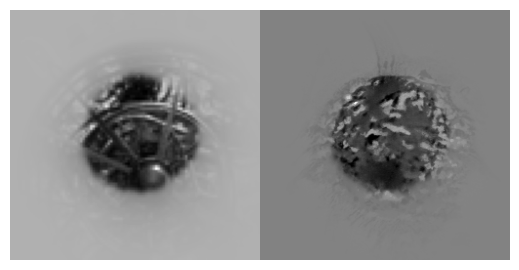

51


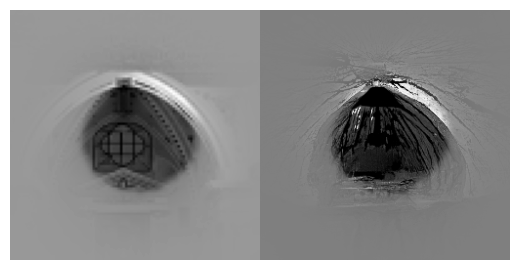

52


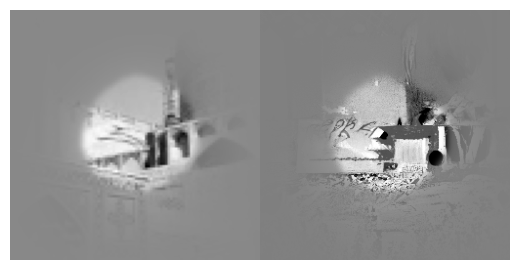

53


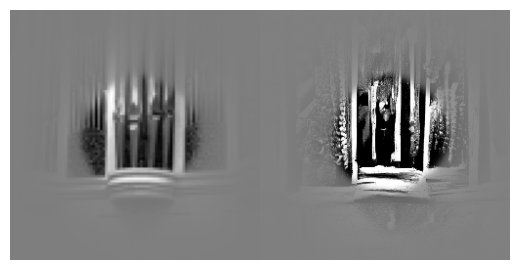

54


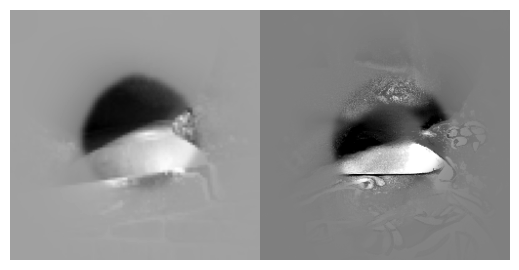

55


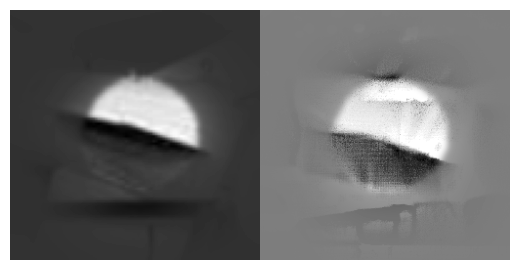

56


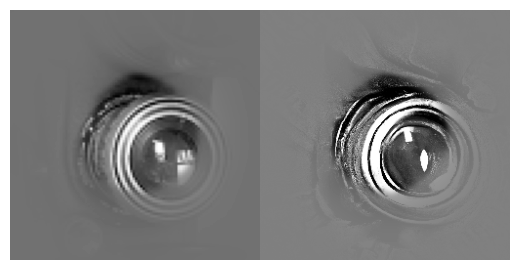

57


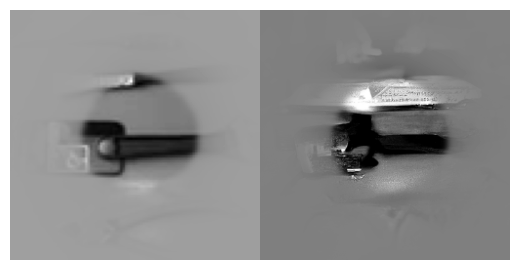

58


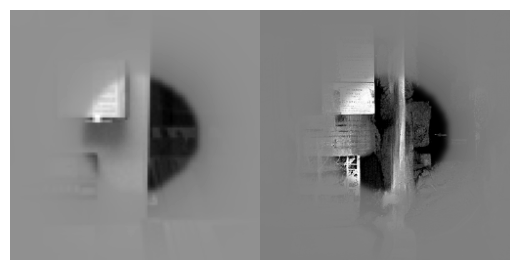

59


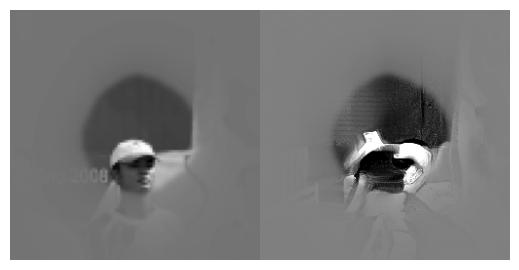

60


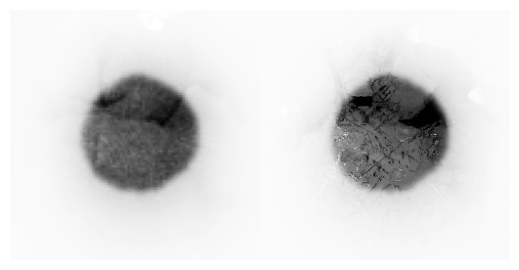

61


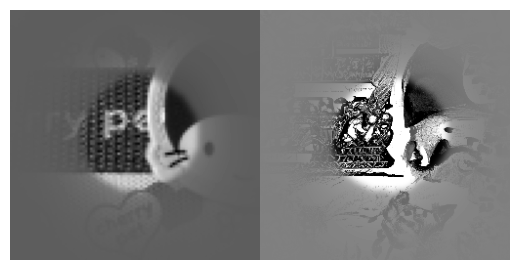

62


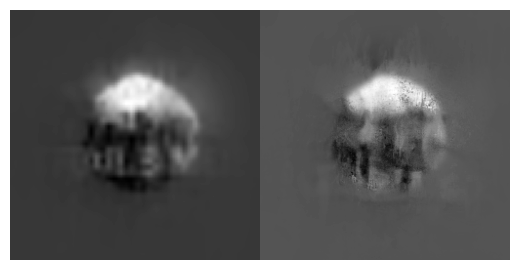

63


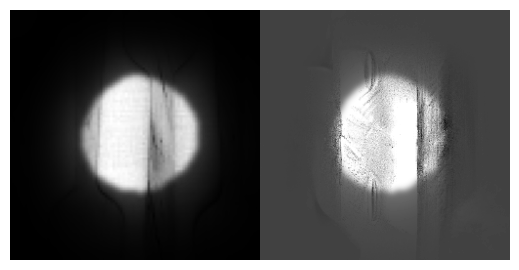

64


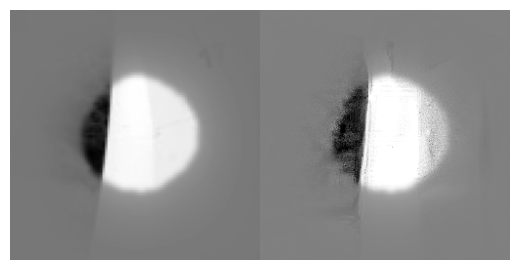

65


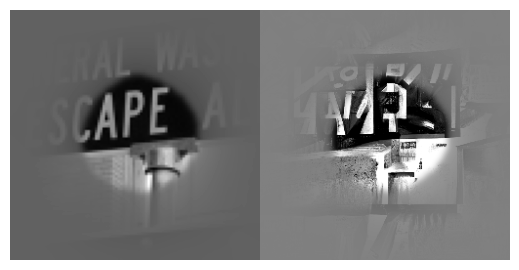

66


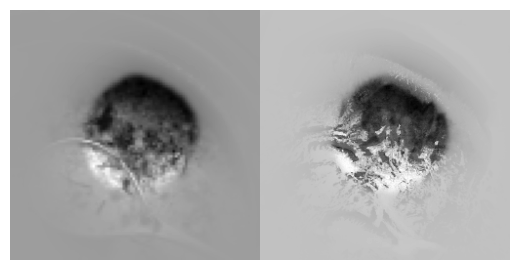

67


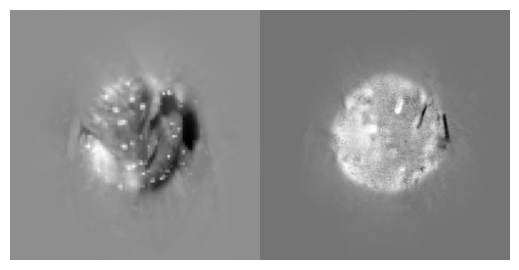

68


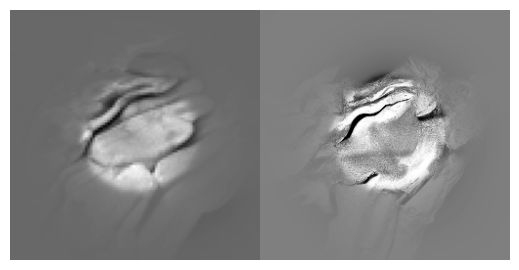

69


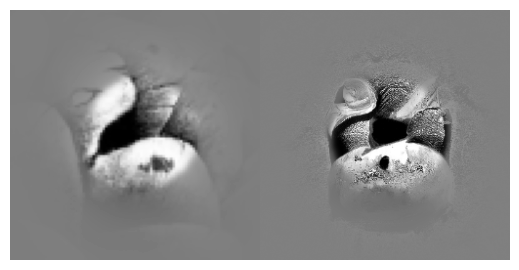

70


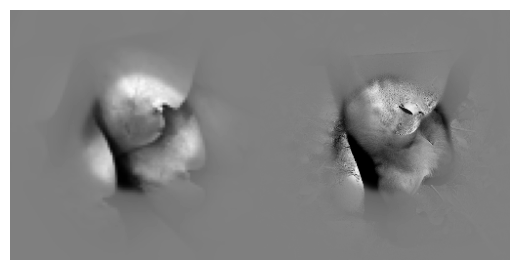

71


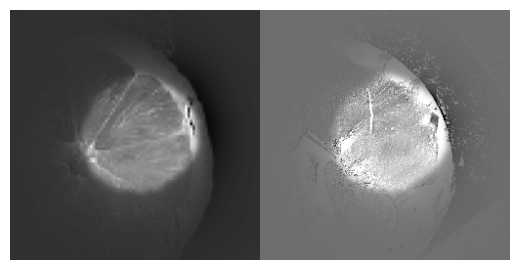

72


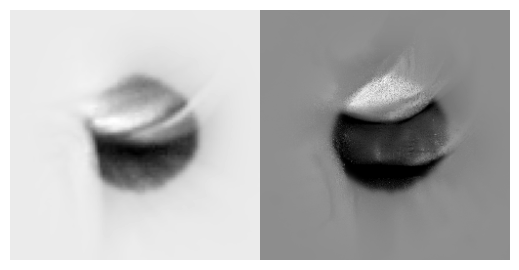

73


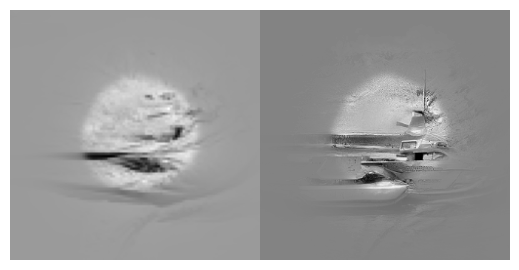

74


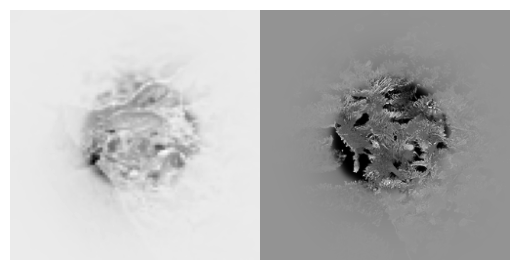

In [14]:
nimages = 75

for i in range(nimages):
    print(i)
    fig, axs = plt.subplots(1, 2, figsize=(2 * 2.5, 2.5))
    plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
    plt.margins(0, 0)
    imshow(mask_image(gt_images[i], mask_100).squeeze(), ax=axs[0])
    imshow(mask_image(run.get_image(history.iloc[i])[..., 0] / 255 * 4 - 2, mask).squeeze(), ax=axs[1])
    plt.show()

Chosen 12 images


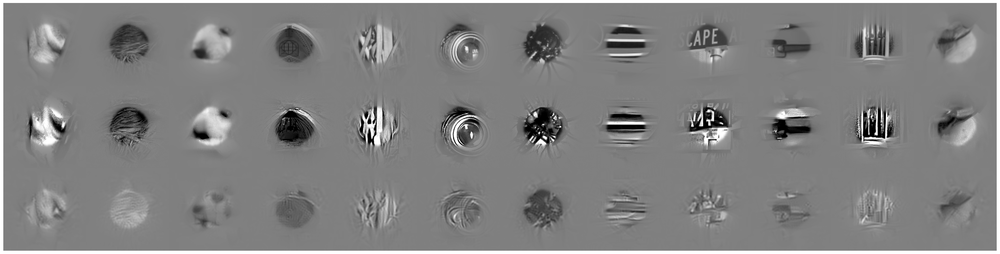

In [22]:
curated = np.array([8, 12, 17, 18, 22, 25, 56, 47, 53, 57, 51, 65])

np.random.seed(1)
np.random.shuffle(curated)

nimages = len(curated)
print(f"Chosen {nimages} images")

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    # imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    # imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])

    imshow(mask_image(gt_images[image_idx], mask_100).squeeze(), ax=axs[0, pos_idx])
    imshow(mask_image(run.get_image(history.iloc[image_idx])[..., 0] / 255 * 4 - 2, mask).squeeze(), ax=axs[1, pos_idx])
    imshow(mask_image(run_gd.get_image(history_gd.iloc[image_idx]) / 255 * 4 - 2, mask_100).squeeze(), ax=axs[2, pos_idx])

    # try:
    #     img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    # except:
    #     img_gd = np.zeros((100, 100))
    # imshow(img_gd, ax=axs[2, pos_idx])

plt.savefig("./recon.png", dpi=150, bbox_inches="tight", pad_inches=0)

Chosen 4 images


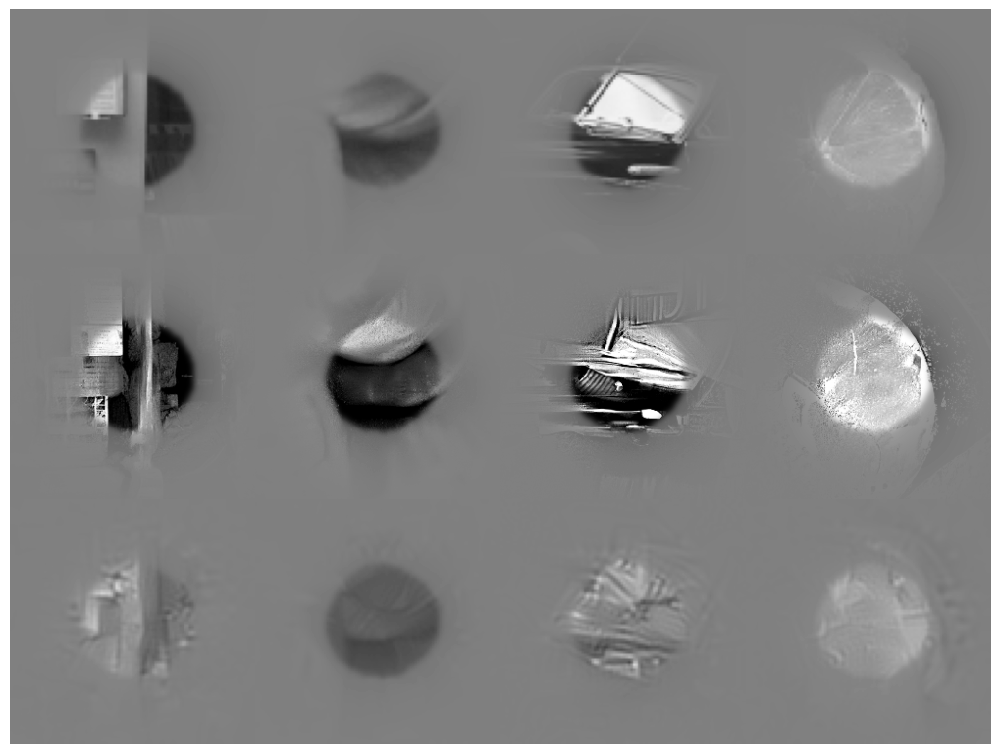

In [20]:
curated = np.array([48, 71, 72, 58])

np.random.seed(1)
np.random.shuffle(curated)

nimages = len(curated)
print(f"Chosen {nimages} images")

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    imshow(mask_image(gt_images[image_idx], mask_100).squeeze(), ax=axs[0, pos_idx])
    imshow(mask_image(run.get_image(history.iloc[image_idx])[..., 0] / 255 * 4 - 2, mask).squeeze(), ax=axs[1, pos_idx])
    imshow(mask_image(run_gd.get_image(history_gd.iloc[image_idx]) / 255 * 4 - 2, mask_100).squeeze(), ax=axs[2, pos_idx])

    # imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    # imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])
    # 
    # try:
    #     img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    # except:
    #     img_gd = np.zeros((100, 100))
    # imshow(img_gd, ax=axs[2, pos_idx])

plt.savefig("./recon_examples.png", dpi=150, bbox_inches="tight", pad_inches=0)

Chosen 12 images


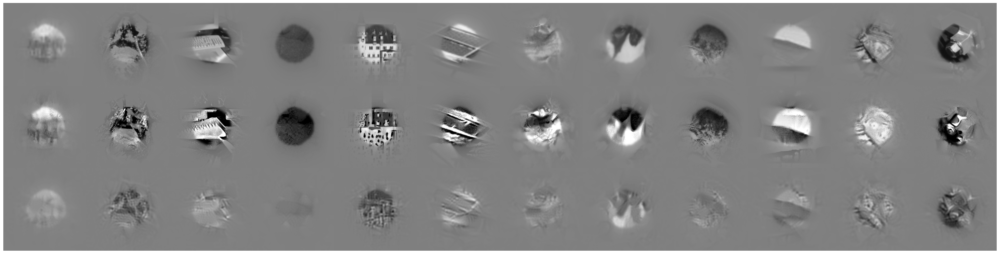

In [13]:
units = np.arange(75)
units = np.delete(
    units, [41, 48, 71, 72, 58, 8, 12, 17, 18, 22, 25, 56, 47, 53, 57, 51, 65]
)

np.random.seed(1)
us = np.random.choice(units, 25, replace=False)
us = np.delete(us, 4)

curated = us[:12]

nimages = len(curated)
print(f"Chosen {nimages} images")

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    # imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    # imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])
    # 
    # try:
    #     img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    # except:
    #     img_gd = np.zeros((100, 100))
    # imshow(img_gd, ax=axs[2, pos_idx])
    
    imshow(mask_image(gt_images[image_idx], mask_100).squeeze(), ax=axs[0, pos_idx])
    imshow(mask_image(run.get_image(history.iloc[image_idx])[..., 0] / 255 * 4 - 2, mask).squeeze(), ax=axs[1, pos_idx])
    imshow(mask_image(run_gd.get_image(history_gd.iloc[image_idx]) / 255 * 4 - 2, mask_100).squeeze(), ax=axs[2, pos_idx])

plt.savefig("./recon_supplementary_masked.png", dpi=150, bbox_inches="tight", pad_inches=0)

Chosen 12 images
30
11
64
32
69
36
50
61
33
73
37
15


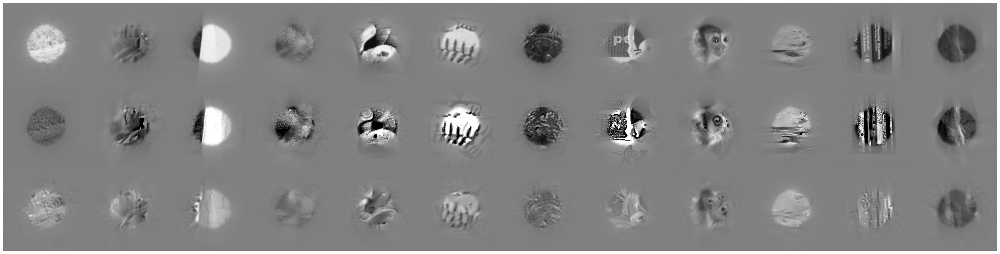

In [11]:
units = np.arange(75)
units = np.delete(
    units, [41, 48, 71, 72, 58, 8, 12, 17, 18, 22, 25, 56, 47, 53, 57, 51, 65]
)

np.random.seed(1)
us = np.random.choice(units, 27, replace=False)
us = np.delete(us, 4)
us = np.delete(us, [12, 22])

curated = us[12:]

nimages = len(curated)
print(f"Chosen {nimages} images")

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    print(image_idx)
    # imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    # imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])
    imshow(mask_image(gt_images[image_idx], mask_100).squeeze(), ax=axs[0, pos_idx])
    imshow(mask_image(run.get_image(history.iloc[image_idx])[..., 0] / 255 * 4 - 2, mask).squeeze(), ax=axs[1, pos_idx])
    imshow(mask_image(run_gd.get_image(history_gd.iloc[image_idx]) / 255 * 4 - 2, mask_100).squeeze(), ax=axs[2, pos_idx])


    # try:
    #     img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    # except:
    #     img_gd = np.zeros((100, 100))
    # imshow(img_gd, ax=axs[2, pos_idx])

plt.savefig("./recon_supplementary_2_masked.png", dpi=150, bbox_inches="tight", pad_inches=0)

Chosen 12 images


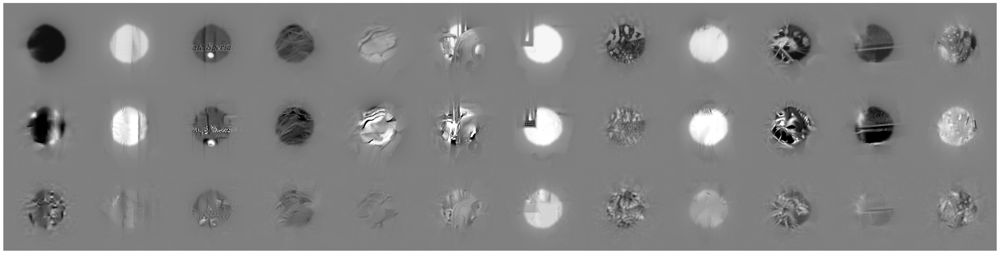

In [12]:
units = np.arange(75)
units = np.delete(
    units, [41, 48, 71, 72, 58, 8, 12, 17, 18, 22, 25, 56, 47, 53, 57, 51, 65]
)

np.random.seed(1)
us = np.random.choice(units, 39, replace=False)
us = np.delete(us, 4)
us = np.delete(us, [12, 22])

curated = us[24:]

nimages = len(curated)
print(f"Chosen {nimages} images")

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    # imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    # imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])
    # 
    # try:
    #     img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    # except:
    #     img_gd = np.zeros((100, 100))
    # imshow(img_gd, ax=axs[2, pos_idx])
    
    imshow(mask_image(gt_images[image_idx], mask_100).squeeze(), ax=axs[0, pos_idx])
    imshow(mask_image(run.get_image(history.iloc[image_idx])[..., 0] / 255 * 4 - 2, mask).squeeze(), ax=axs[1, pos_idx])
    imshow(mask_image(run_gd.get_image(history_gd.iloc[image_idx]) / 255 * 4 - 2, mask_100).squeeze(), ax=axs[2, pos_idx])



plt.savefig("./recon_supplementary_3_masked.png", dpi=150, bbox_inches="tight", pad_inches=0)

In [ ]:
np.save("./target_l2.npy", history["train"].to_numpy())

In [119]:
df = history.merge(history_gd, on="unit_idx", suffixes=["_d", "_m"])

In [124]:
print(df["train_m"].mean(), df["train_d"].mean())
print(df["val_m"].mean(), df["val_d"].mean())
print(df["cross-val_m"].mean(), df["cross-val_d"].mean())

0.005861769068620301 0.005844662764242717
0.0071249169081316465 0.00651150535434551
0.5187983571418694 0.1531367632560432


In [127]:
import scipy.stats as st

print(st.wilcoxon(df["val_d"], df["val_m"]))
print(st.wilcoxon(df["cross-val_d"], df["cross-val_m"]))

WilcoxonResult(statistic=186.0, pvalue=5.971528245007682e-07)
WilcoxonResult(statistic=3.0, pvalue=8.880118337733133e-11)


NameError: name 'df' is not defined

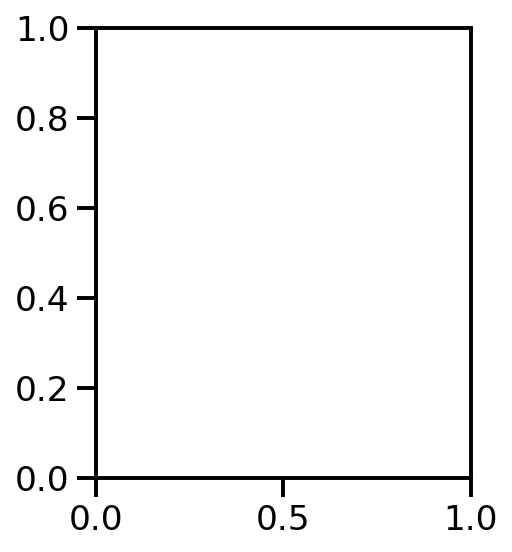

In [37]:
import seaborn as sns

sns.set_context("talk")
plt.figure(figsize=(5, 3), dpi=150, facecolor="w")
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.subplot(1, 2, 1)
plt.bar(
    [0 - 0.2],
    [df["val_d"].mean()],
    color=[palettes["candy"]["yellow"], palettes["candy"]["yellow"]],
    edgecolor="k",
    linewidth=3,
    width=0.4,
    label="EGG",
)
plt.bar(
    [0 + 0.2],
    [df["val_m"].mean()],
    color=[palettes["candy"]["green"], palettes["candy"]["green"]],
    edgecolor="k",
    linewidth=3,
    width=0.4,
    label="GA",
)

plt.xlim(-0.5, 1.5)
plt.ylim(0, 0.01)

plt.xticks([-0.5, 0, 0.5], ["", "Within", ""])
plt.yticks([0, 0.002, 0.004, 0.006, 0.008, 0.010])

plt.ylabel("$L_2$ Distance")
plt.subplot(1, 2, 2)
plt.bar(
    [0 - 0.2],
    [df["cross-val_d"].mean()],
    color=[palettes["candy"]["yellow"], palettes["candy"]["yellow"]],
    edgecolor="k",
    linewidth=3,
    width=0.4,
    label="EGG",
)
plt.bar(
    [0 + 0.2],
    [df["cross-val_m"].mean()],
    color=[palettes["candy"]["green"], palettes["candy"]["green"]],
    edgecolor="k",
    linewidth=3,
    width=0.4,
    label="GA",
)

plt.xlim(-0.5, 1.5)

plt.xticks([-0.5, 0, 0.5], ["", "Cross", ""])
plt.yticks([0, 0.2, 0.4, 0.6])
plt.ylim(0, 1)

sns.despine(trim=True)
plt.legend(frameon=False, bbox_to_anchor=(0.6, 1))
plt.tight_layout()
plt.savefig("reconstruction_error.png", dpi=150, bbox_inches="tight", pad_inches=0)

In [192]:
print(sum(df["val_d"] < df["val_m"]) / len(df["val_d"]))
print(sum(df["cross-val_d"] < df["cross-val_m"]) / len(df["val_d"]))

0.8392857142857143
0.9821428571428571


In [14]:
gt_images = np.load("../data/75_monkey_test_imgs.npy")
run = WandbRun("e7kd580o")
run_gd = WandbRun("vlr0s30b")
history = run.history()
history_gd = run_gd.history()

Chosen 12 images


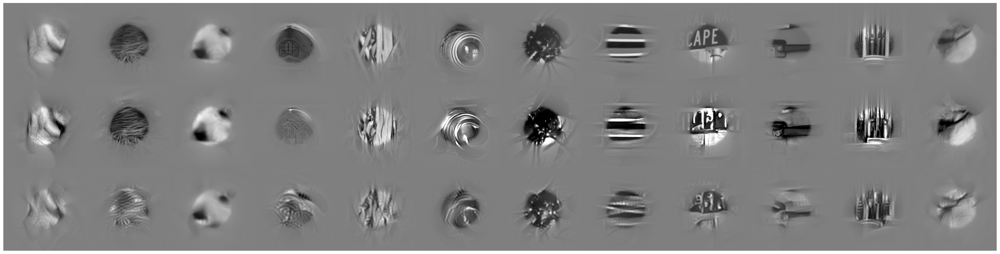

In [15]:
curated = np.array([8, 12, 17, 18, 22, 25, 56, 47, 53, 57, 51, 65])

np.random.seed(1)
np.random.shuffle(curated)

nimages = len(curated)
print(f"Chosen {nimages} images")

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    # imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    # imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])

    imshow(mask_image(gt_images[image_idx], mask_100).squeeze(), ax=axs[0, pos_idx])
    imshow(mask_image(run.get_image(history.iloc[image_idx])[..., 0] / 255 * 4 - 2, mask).squeeze(), ax=axs[1, pos_idx])
    imshow(mask_image(run_gd.get_image(history_gd.iloc[image_idx]) / 255 * 4 - 2, mask_100).squeeze(), ax=axs[2, pos_idx])

    # try:
    #     img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    # except:
    #     img_gd = np.zeros((100, 100))
    # imshow(img_gd, ax=axs[2, pos_idx])

plt.savefig("./recon_dd.png", dpi=150, bbox_inches="tight", pad_inches=0)

Chosen 12 images


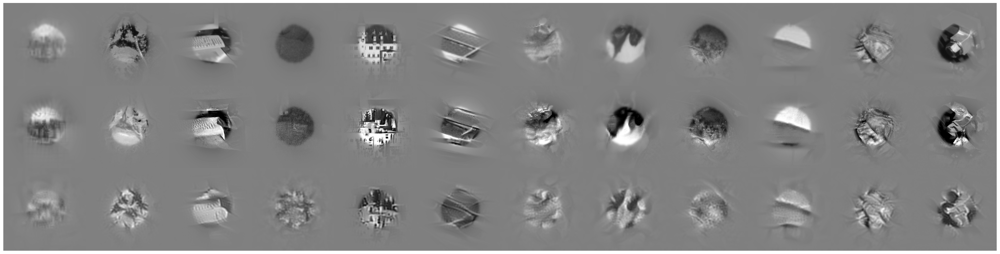

In [16]:
units = np.arange(75)
units = np.delete(
    units, [41, 48, 71, 72, 58, 8, 12, 17, 18, 22, 25, 56, 47, 53, 57, 51, 65]
)

np.random.seed(1)
us = np.random.choice(units, 25, replace=False)
us = np.delete(us, 4)

curated = us[:12]

nimages = len(curated)
print(f"Chosen {nimages} images")

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    # imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    # imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])
    # 
    # try:
    #     img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    # except:
    #     img_gd = np.zeros((100, 100))
    # imshow(img_gd, ax=axs[2, pos_idx])
    
    imshow(mask_image(gt_images[image_idx], mask_100).squeeze(), ax=axs[0, pos_idx])
    imshow(mask_image(run.get_image(history.iloc[image_idx])[..., 0] / 255 * 4 - 2, mask).squeeze(), ax=axs[1, pos_idx])
    imshow(mask_image(run_gd.get_image(history_gd.iloc[image_idx]) / 255 * 4 - 2, mask_100).squeeze(), ax=axs[2, pos_idx])

plt.savefig("./recon_dd_supplementary_masked.png", dpi=150, bbox_inches="tight", pad_inches=0)

Chosen 12 images
30
11
64
32
69
36
50
61
33
73
37
15


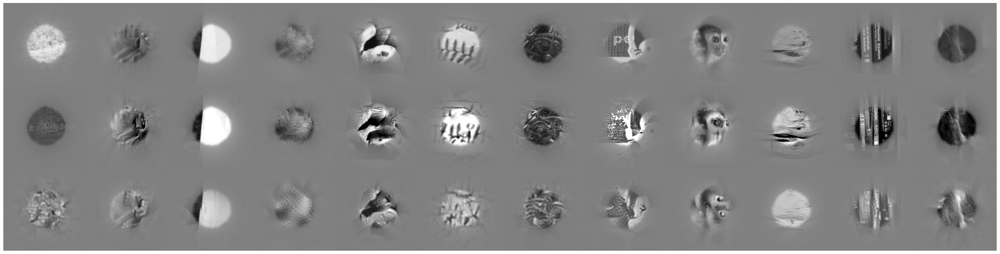

In [17]:
units = np.arange(75)
units = np.delete(
    units, [41, 48, 71, 72, 58, 8, 12, 17, 18, 22, 25, 56, 47, 53, 57, 51, 65]
)

np.random.seed(1)
us = np.random.choice(units, 27, replace=False)
us = np.delete(us, 4)
us = np.delete(us, [12, 22])

curated = us[12:]

nimages = len(curated)
print(f"Chosen {nimages} images")

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    print(image_idx)
    # imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    # imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])
    imshow(mask_image(gt_images[image_idx], mask_100).squeeze(), ax=axs[0, pos_idx])
    imshow(mask_image(run.get_image(history.iloc[image_idx])[..., 0] / 255 * 4 - 2, mask).squeeze(), ax=axs[1, pos_idx])
    imshow(mask_image(run_gd.get_image(history_gd.iloc[image_idx]) / 255 * 4 - 2, mask_100).squeeze(), ax=axs[2, pos_idx])


    # try:
    #     img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    # except:
    #     img_gd = np.zeros((100, 100))
    # imshow(img_gd, ax=axs[2, pos_idx])

plt.savefig("./recon_dd_supplementary_2_masked.png", dpi=150, bbox_inches="tight", pad_inches=0)

Chosen 12 images


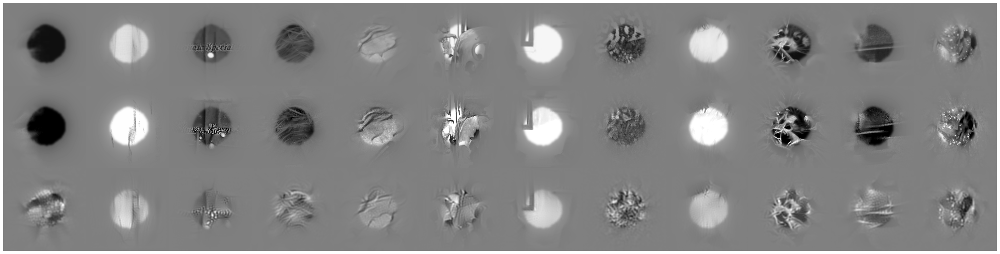

In [18]:
units = np.arange(75)
units = np.delete(
    units, [41, 48, 71, 72, 58, 8, 12, 17, 18, 22, 25, 56, 47, 53, 57, 51, 65]
)

np.random.seed(1)
us = np.random.choice(units, 39, replace=False)
us = np.delete(us, 4)
us = np.delete(us, [12, 22])

curated = us[24:]

nimages = len(curated)
print(f"Chosen {nimages} images")

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    # imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    # imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])
    # 
    # try:
    #     img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    # except:
    #     img_gd = np.zeros((100, 100))
    # imshow(img_gd, ax=axs[2, pos_idx])
    
    imshow(mask_image(gt_images[image_idx], mask_100).squeeze(), ax=axs[0, pos_idx])
    imshow(mask_image(run.get_image(history.iloc[image_idx])[..., 0] / 255 * 4 - 2, mask).squeeze(), ax=axs[1, pos_idx])
    imshow(mask_image(run_gd.get_image(history_gd.iloc[image_idx]) / 255 * 4 - 2, mask_100).squeeze(), ax=axs[2, pos_idx])



plt.savefig("./recon_dd_supplementary_3_masked.png", dpi=150, bbox_inches="tight", pad_inches=0)

0


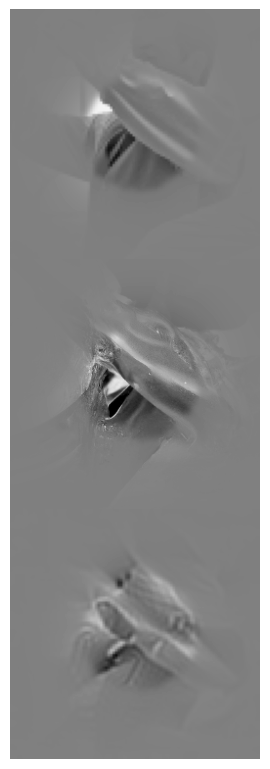

1


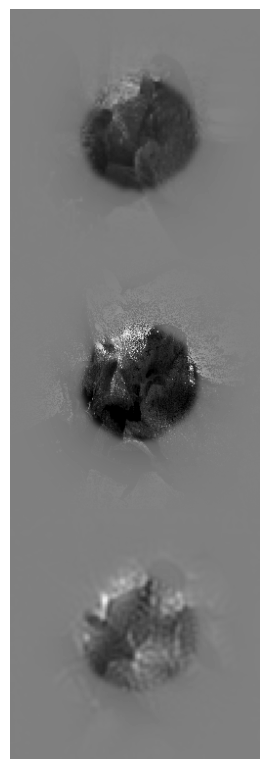

2


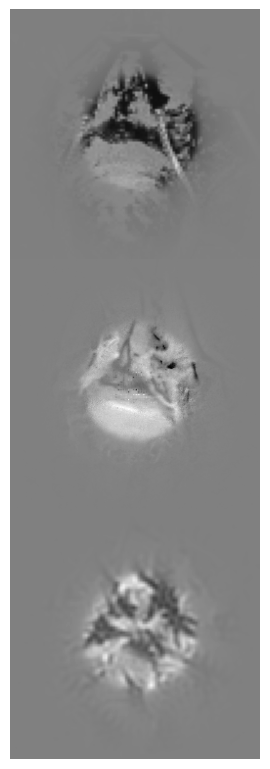

3


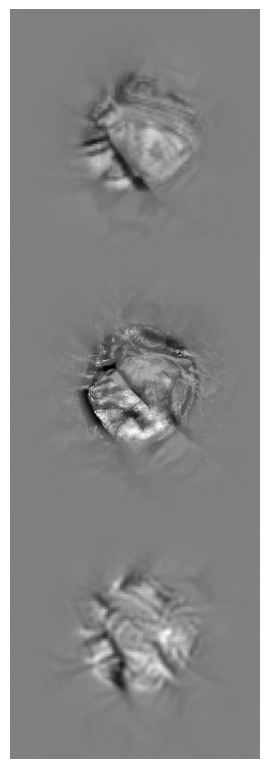

4


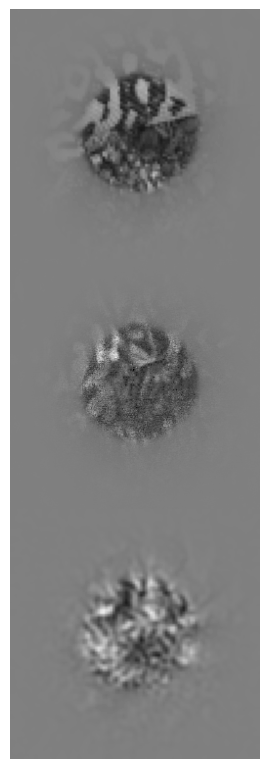

5


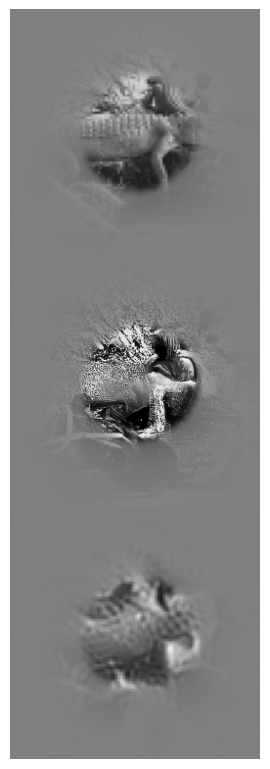

6


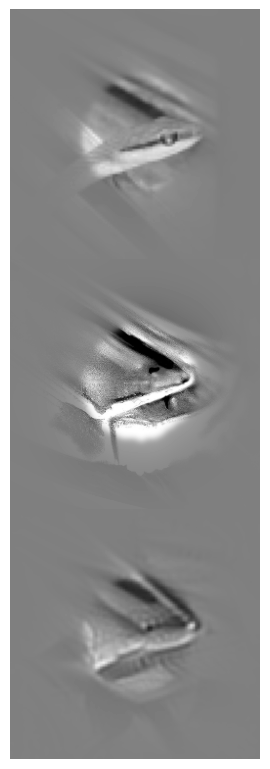

7


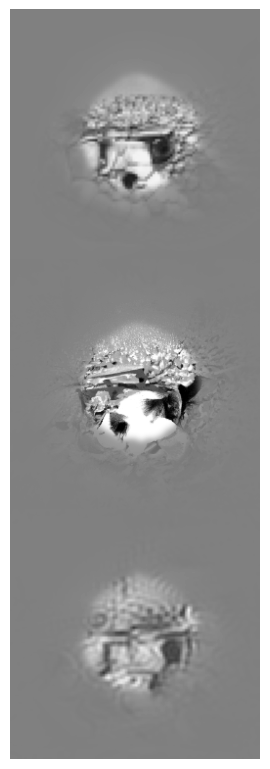

8


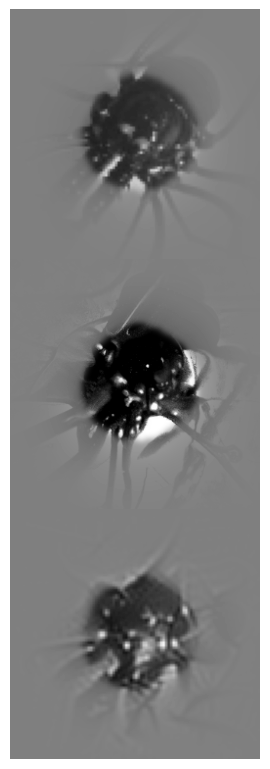

9


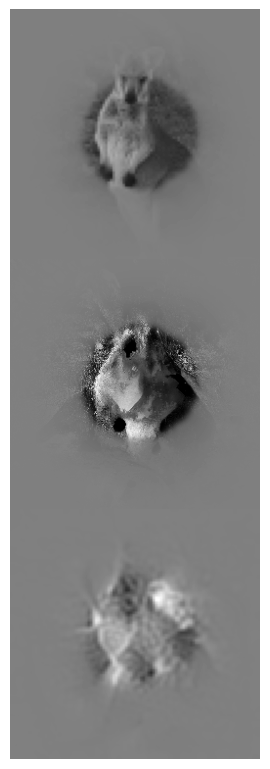

10


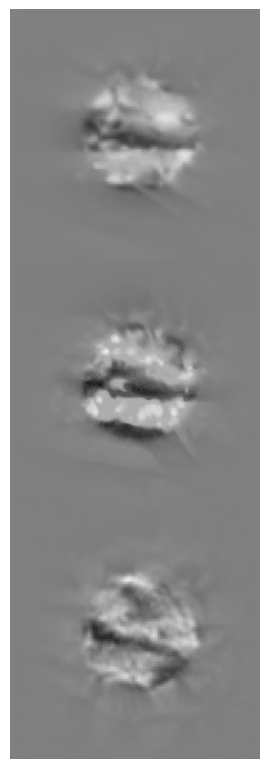

11


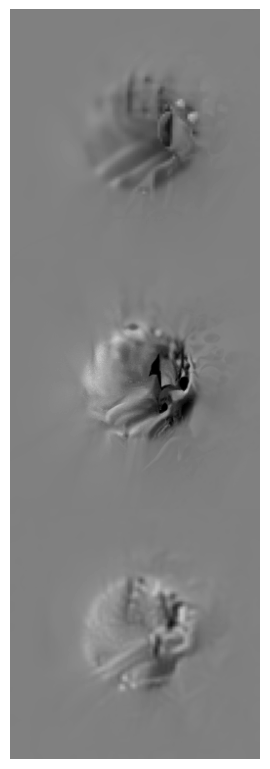

12


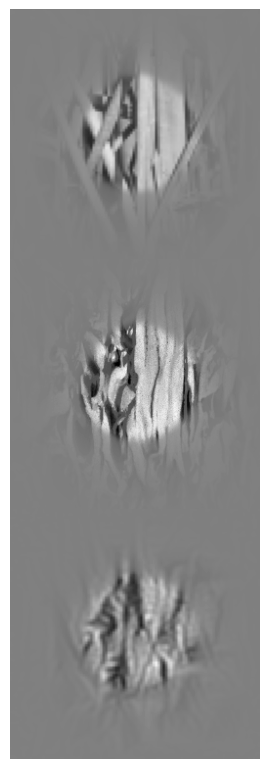

13


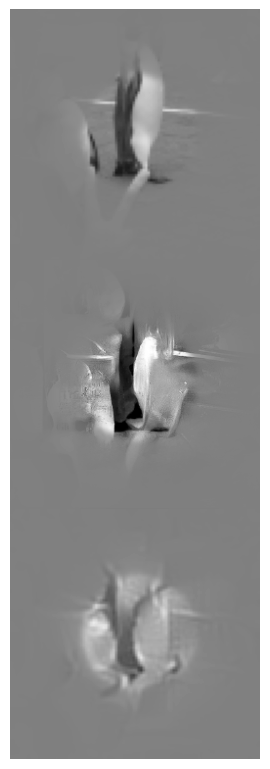

14


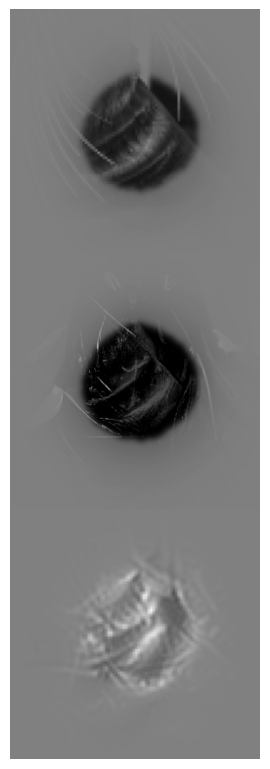

15


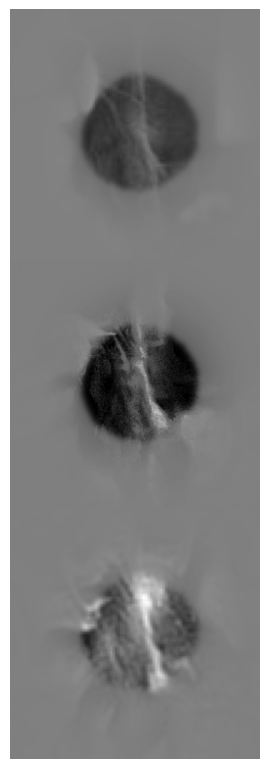

16


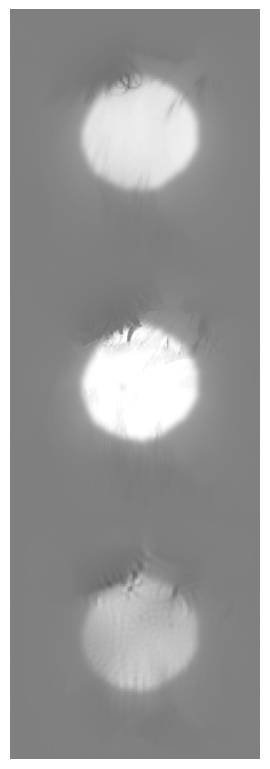

17


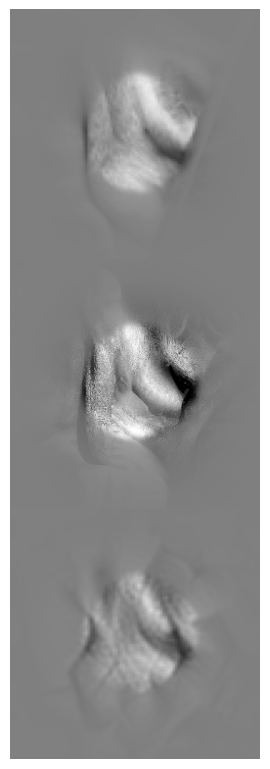

18


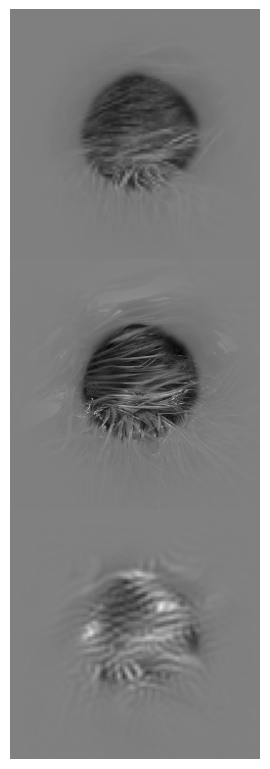

19


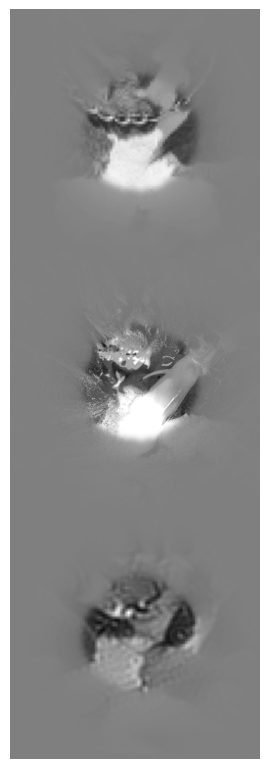

20


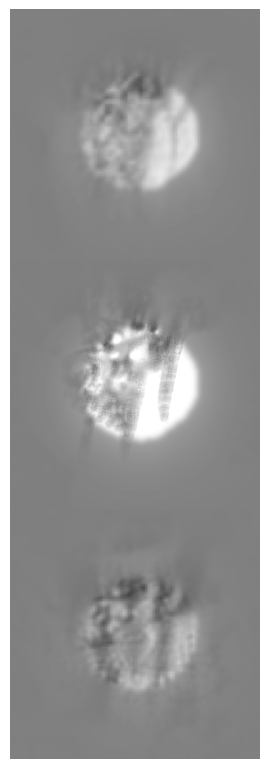

21


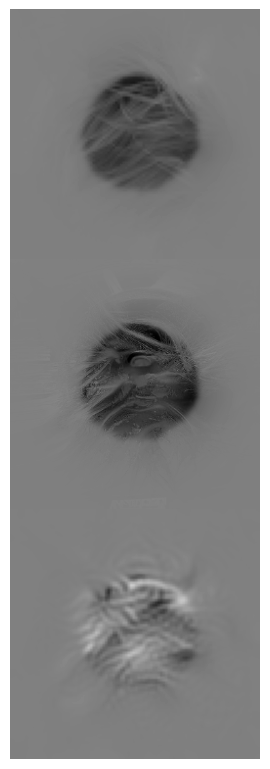

22


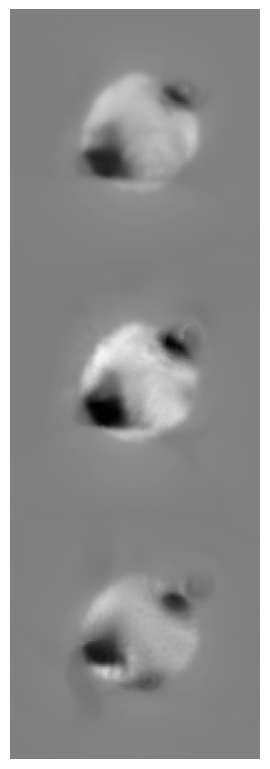

23


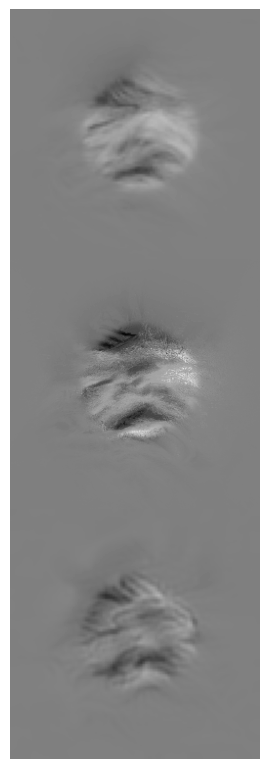

24


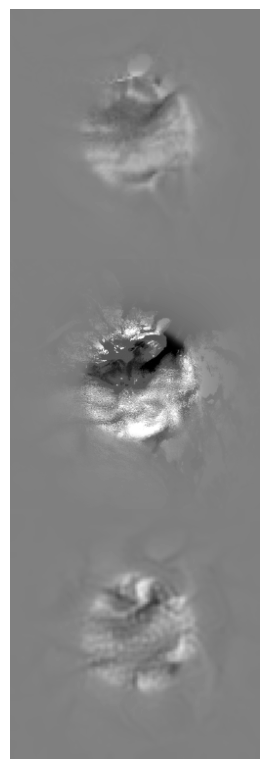

25


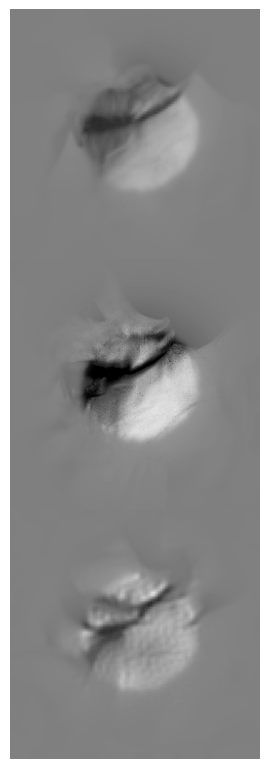

26


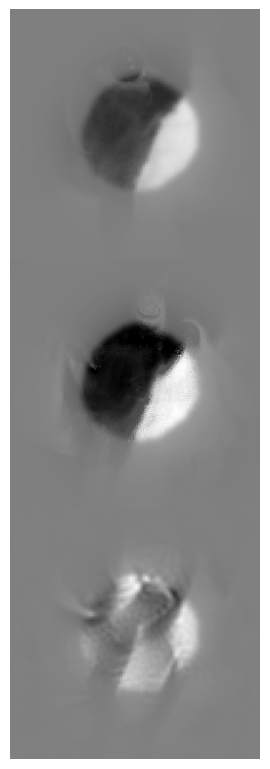

27


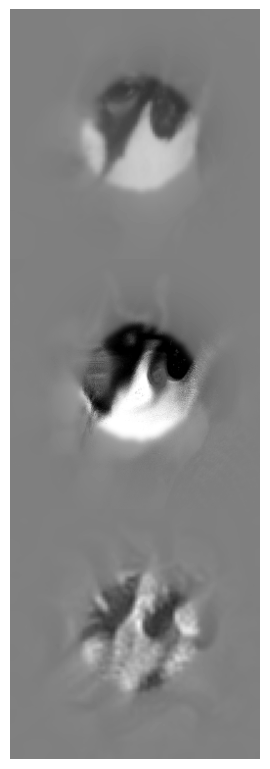

28


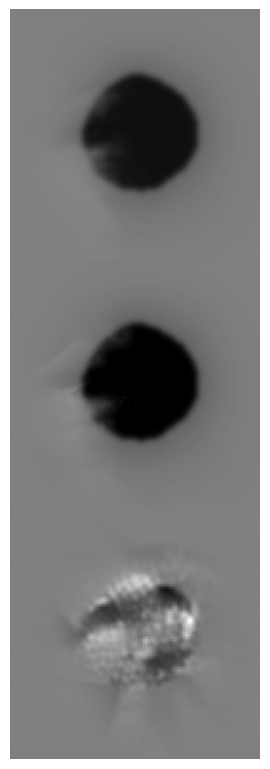

29


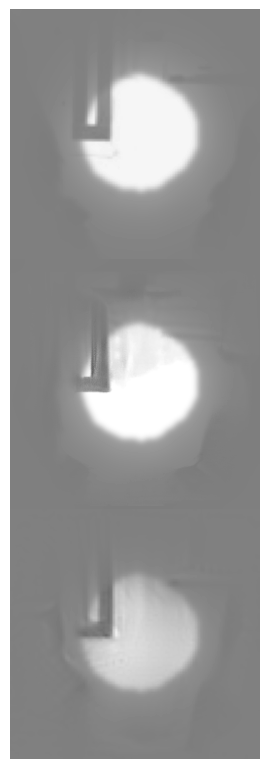

30


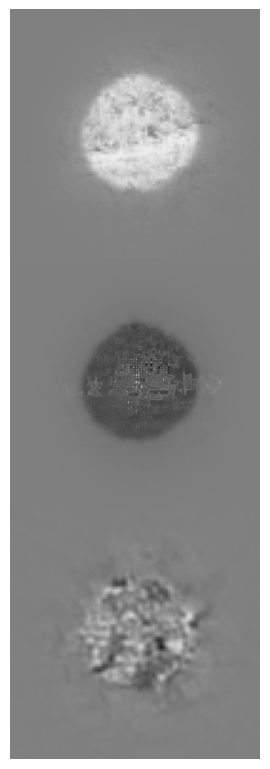

31


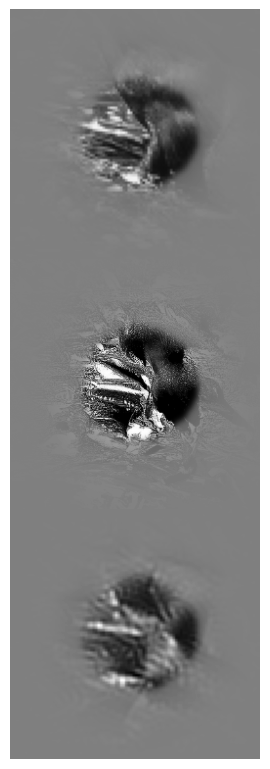

32


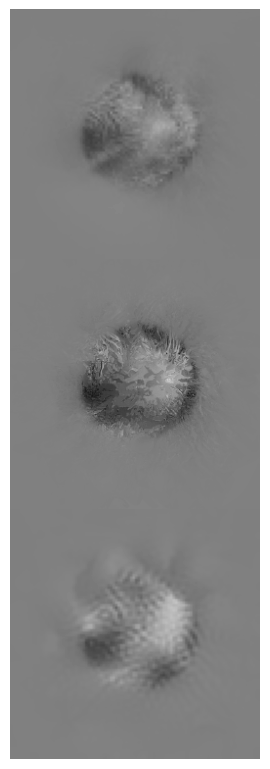

33


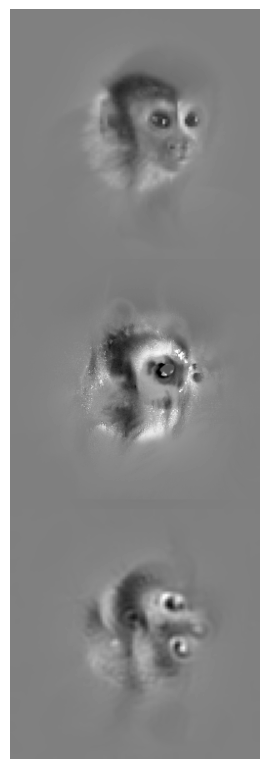

34


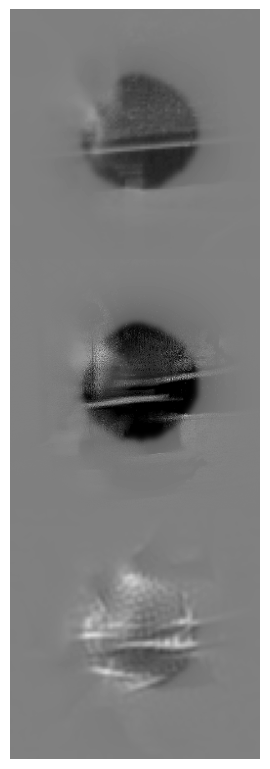

35


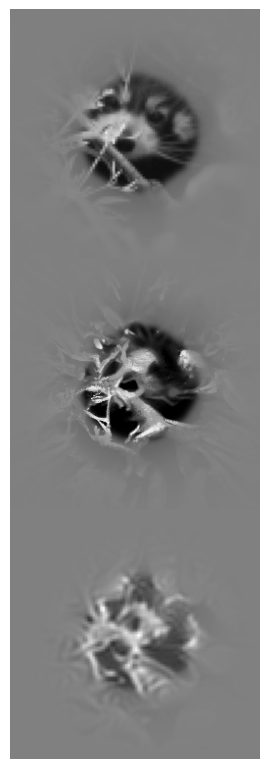

36


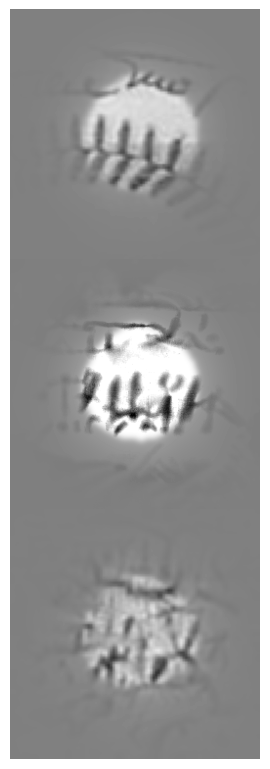

37


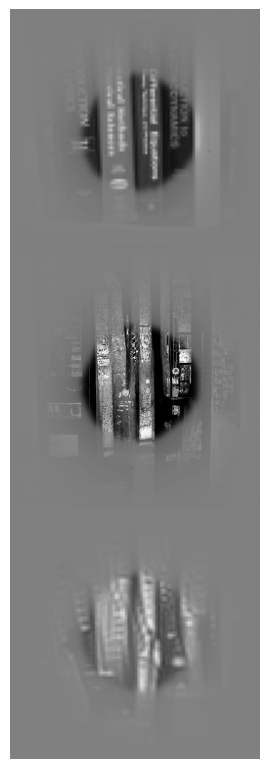

38


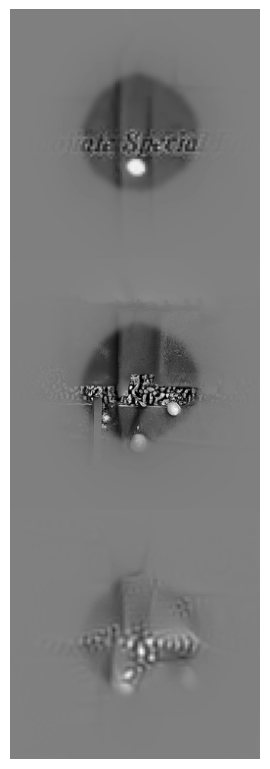

39


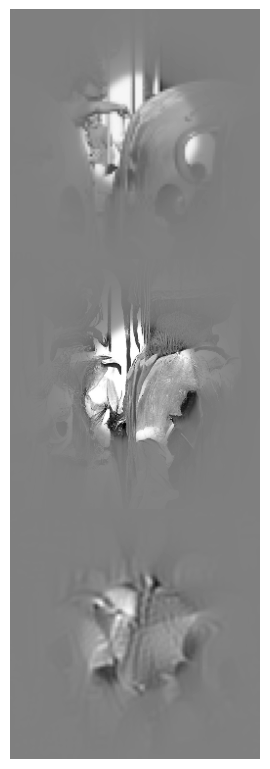

40


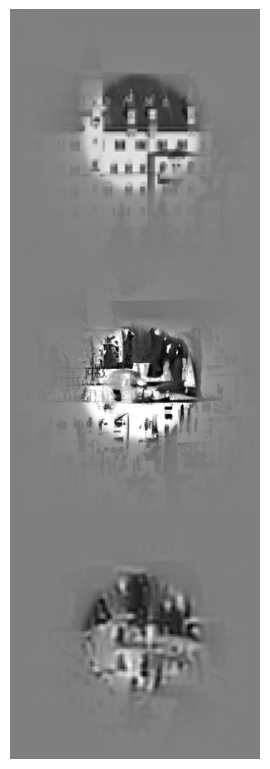

41


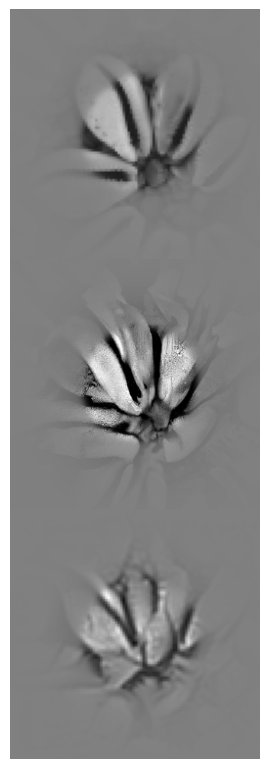

42


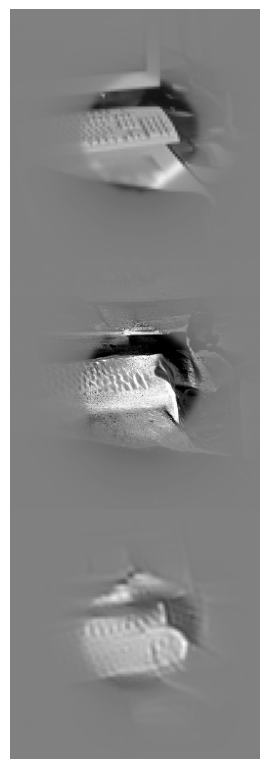

43


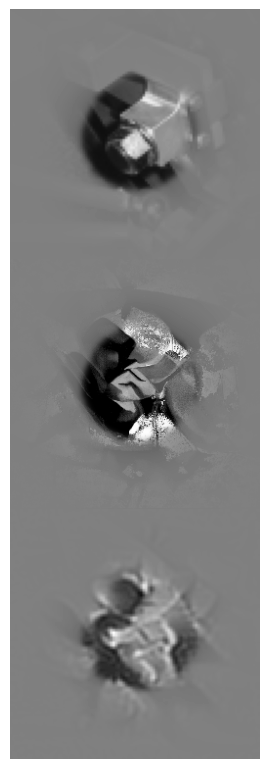

44


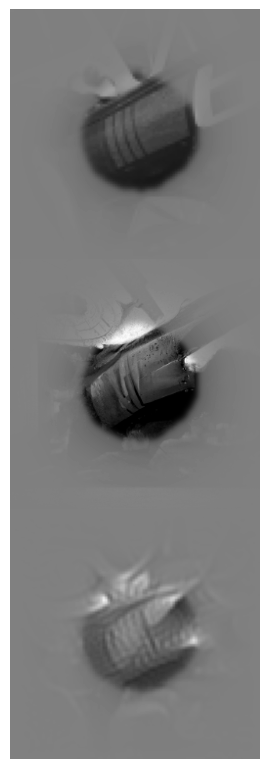

45


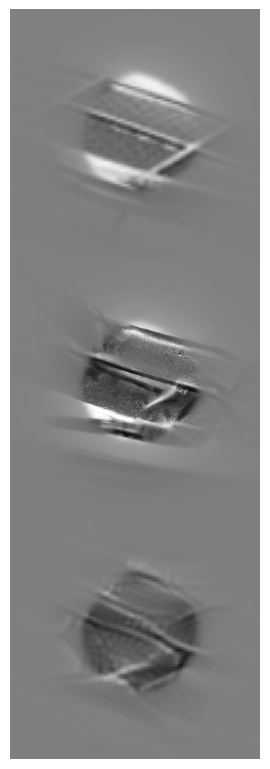

46


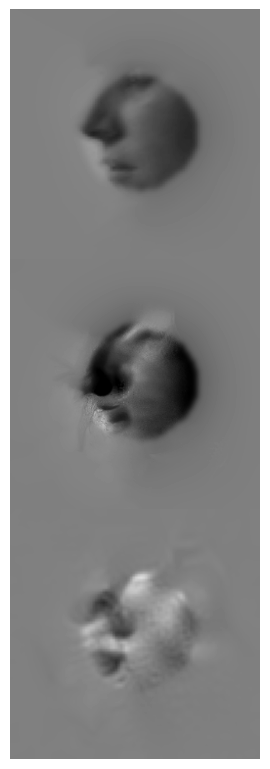

47


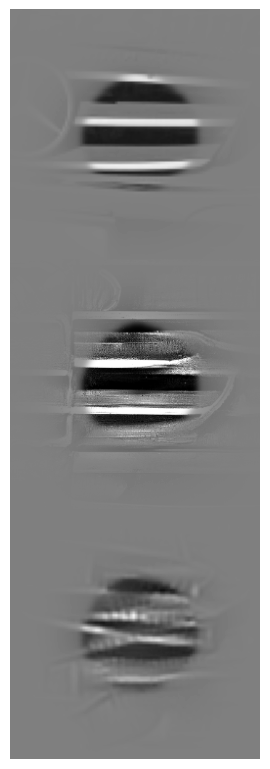

48


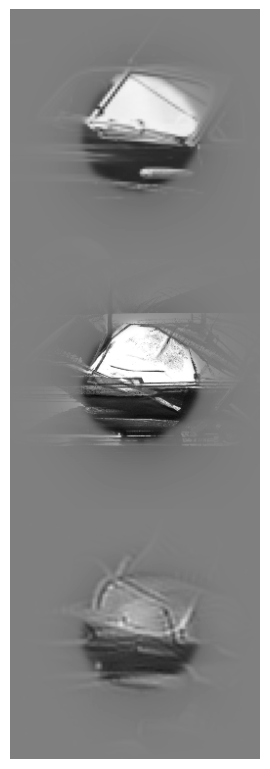

49


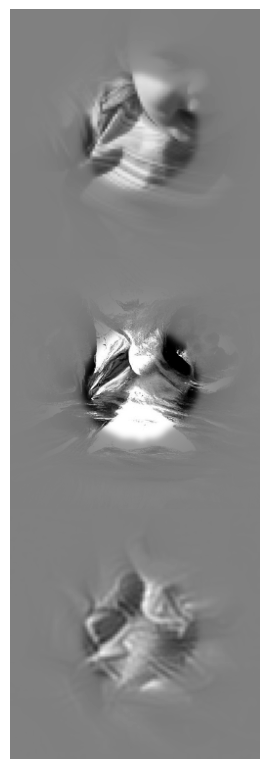

50


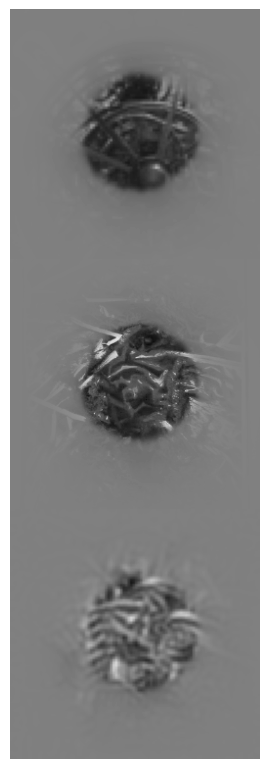

51


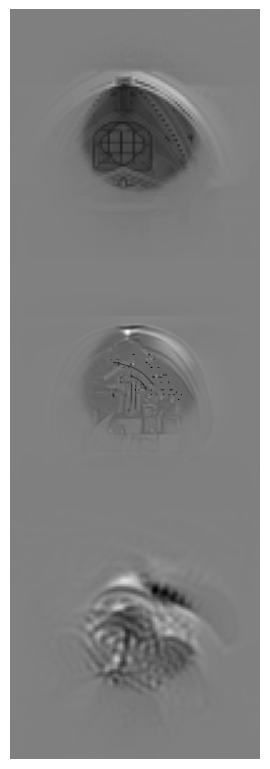

52


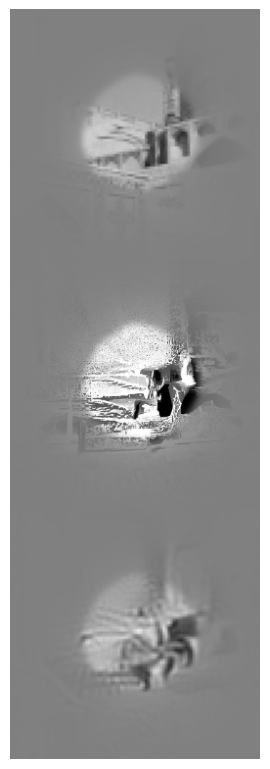

53


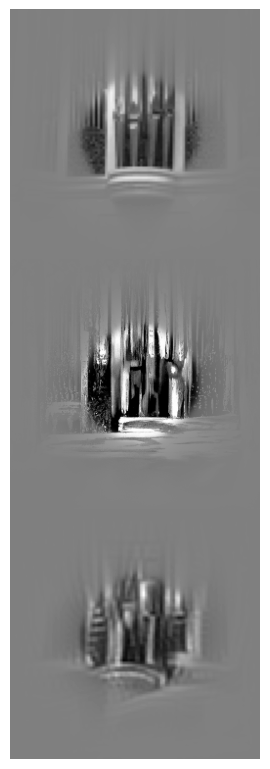

54


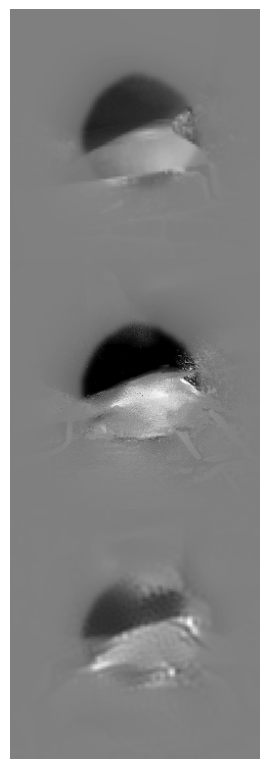

55


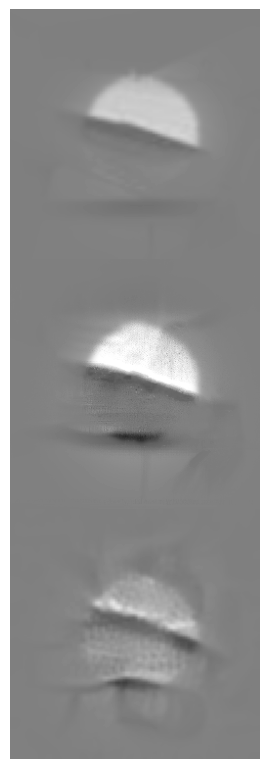

56


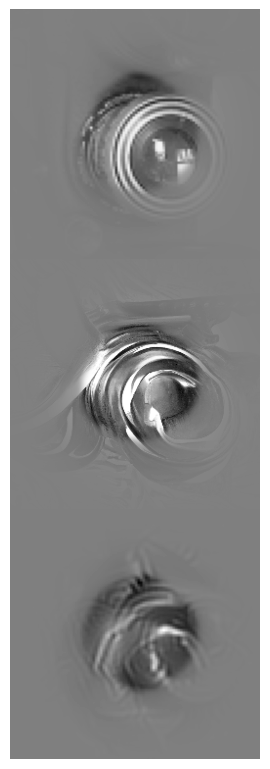

57


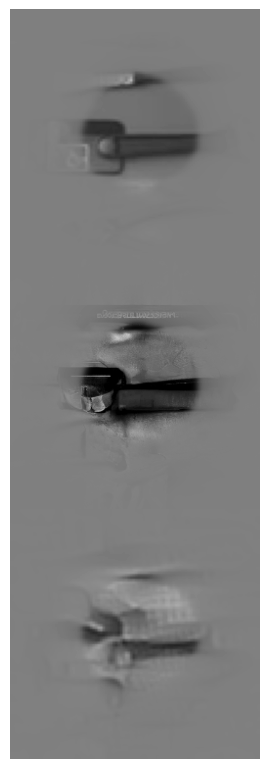

58


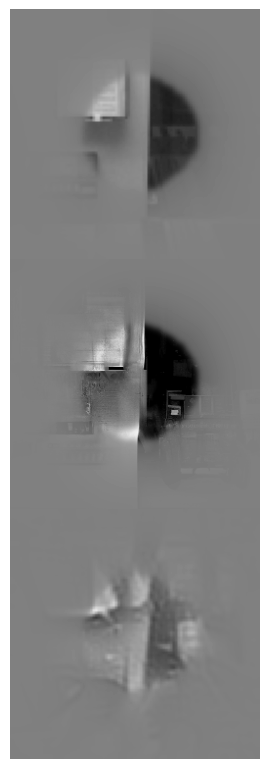

59


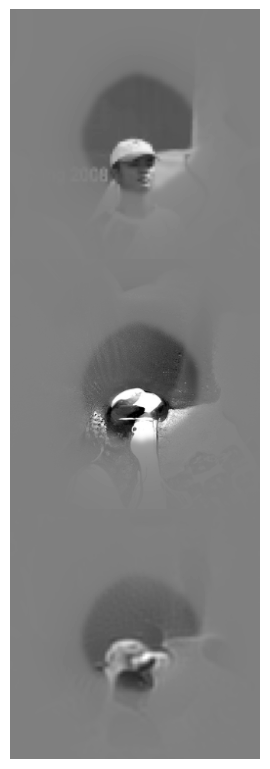

60


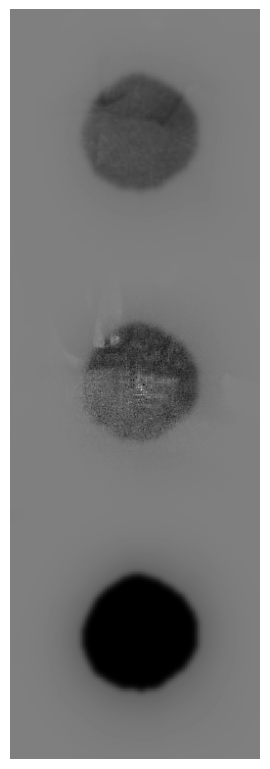

61


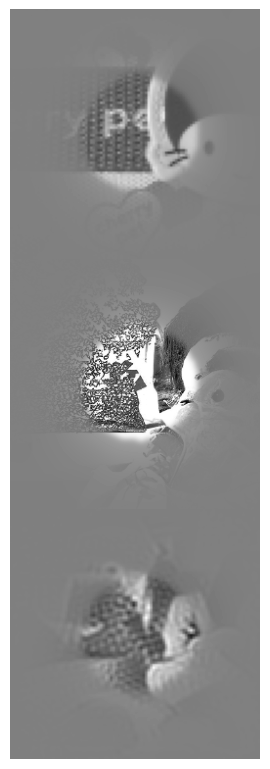

62


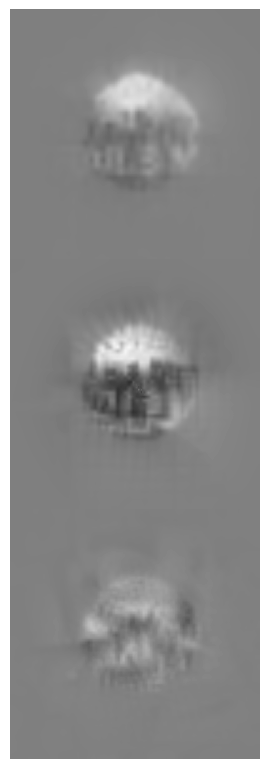

63


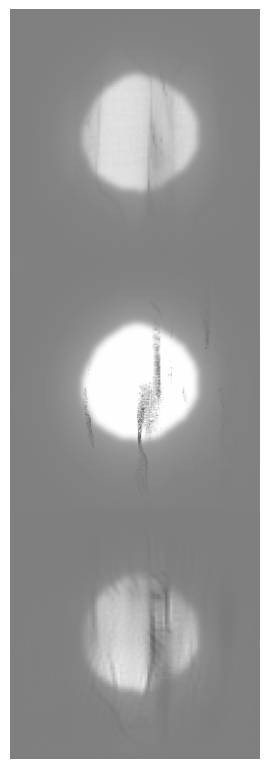

64


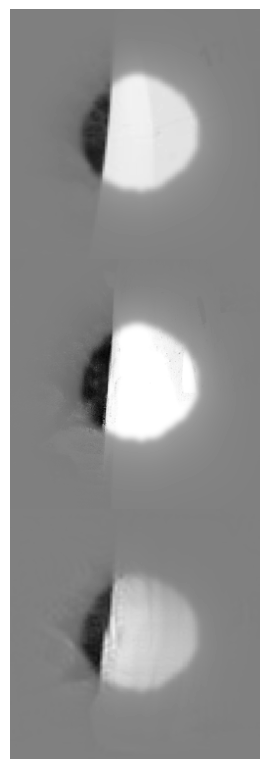

65


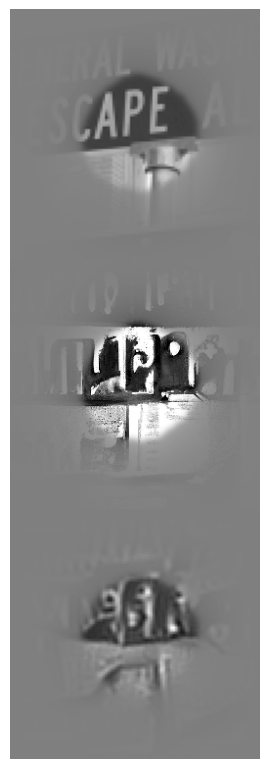

66


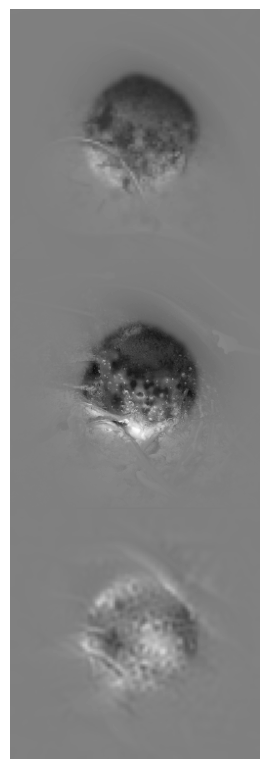

67


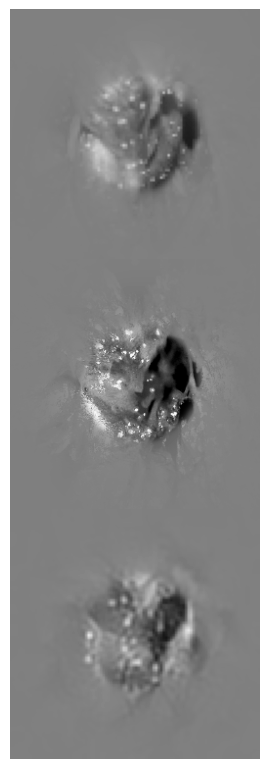

68


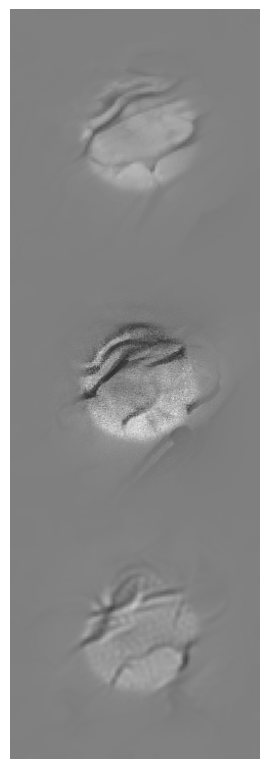

69


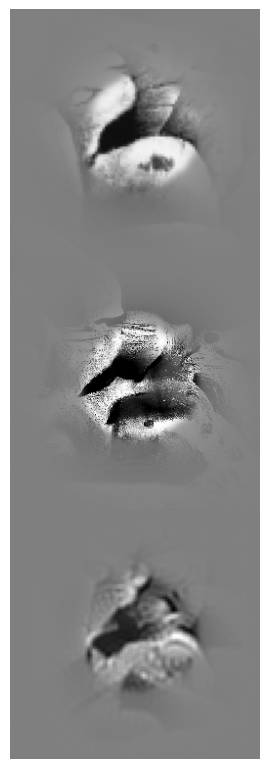

70


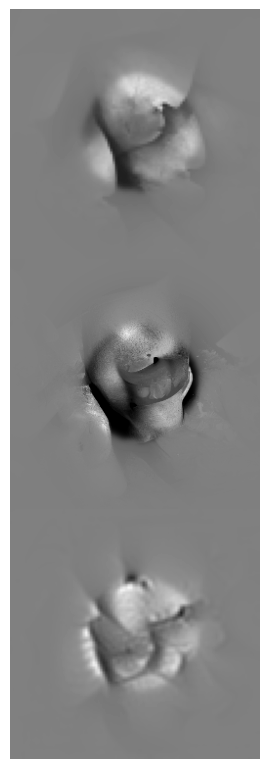

71


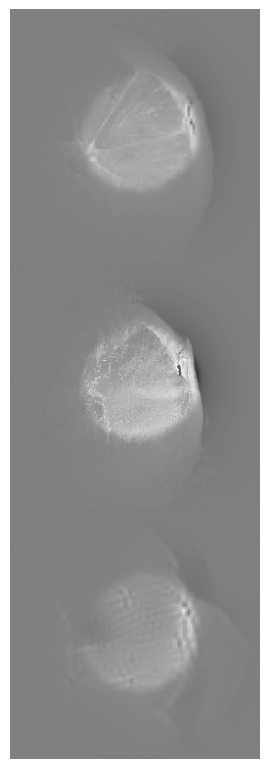

72


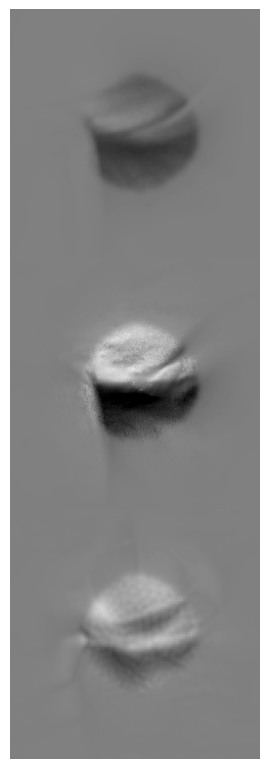

73


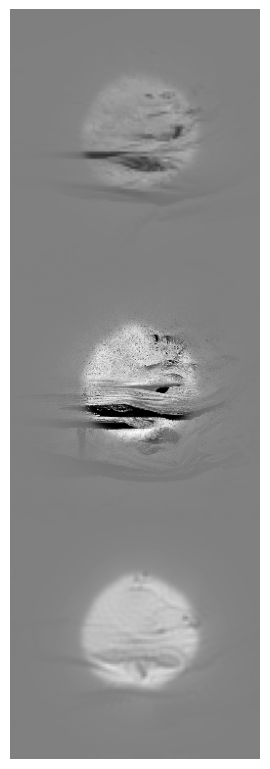

74


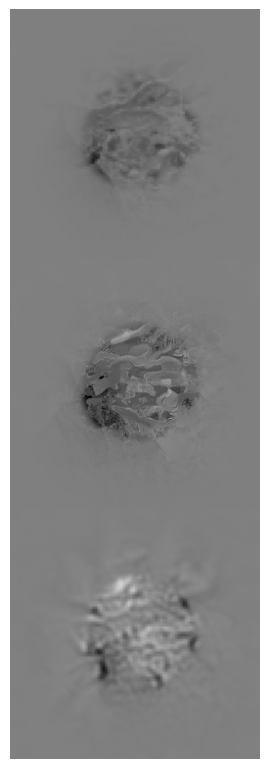

In [35]:
nimages = 75

for i in range(nimages):
    print(i)
    fig, axs = plt.subplots(3, 1, figsize=(2.5, 3 * 2.5))
    plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
    plt.margins(0, 0)
    imshow(mask_image(gt_images[i], mask_100).squeeze(), ax=axs[0])
    imshow(mask_image(run.get_image(history.iloc[i])[..., 0] / 255 * 4 - 2, mask).squeeze(), ax=axs[1])
    imshow(mask_image(run_gd.get_image(history_gd.iloc[i]) / 255 * 4 - 2, mask_100).squeeze(), ax=axs[2])
    plt.show()

In [16]:
np.save('../data/dd_recon_loss.npy', history['train'].to_numpy())

In [22]:
print(history['cross-val'].mean(), history_gd['cross-val'].mean())

0.07028702390690644 0.1353477931767702


In [23]:
print(history['val'].mean(), history_gd['val'].mean())

0.02697956915013492 0.03827639545003573


In [24]:
import scipy.stats as st

print(st.wilcoxon(history["val"], history_gd["val"]))
print(st.wilcoxon(history["cross-val"], history_gd["cross-val"]))

WilcoxonResult(statistic=187.0, pvalue=6.262704499503919e-11)
WilcoxonResult(statistic=91.0, pvalue=1.8644598131184155e-12)


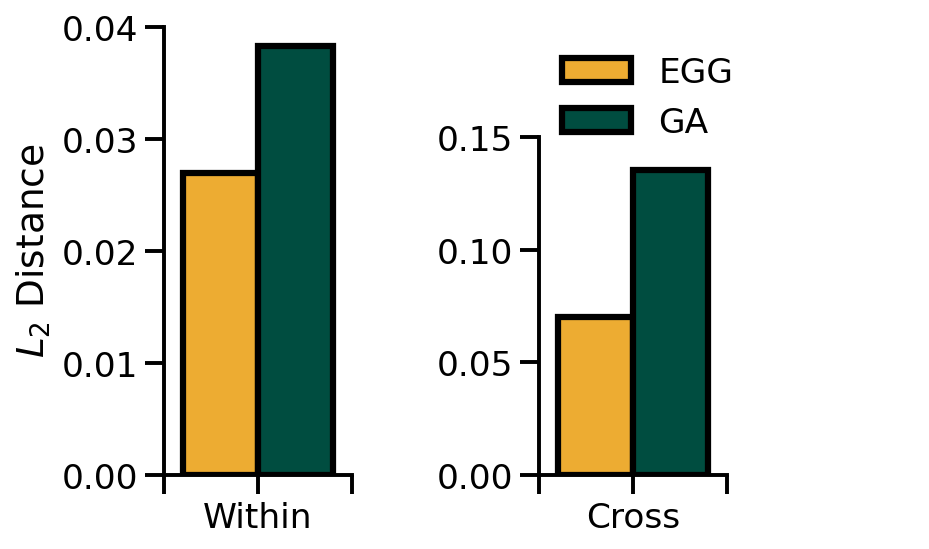

In [38]:
import seaborn as sns

plt.style.use('default')
sns.set_context("talk")
plt.figure(figsize=(5, 3), dpi=150, facecolor="w")
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.subplot(1, 2, 1)
plt.bar(
    [0 - 0.2],
    [history["val"].mean()],
    color=[palettes["candy"]["yellow"], palettes["candy"]["yellow"]],
    edgecolor="k",
    linewidth=3,
    width=0.4,
    label="EGG",
)
plt.bar(
    [0 + 0.2],
    [history_gd["val"].mean()],
    color=[palettes["candy"]["green"], palettes["candy"]["green"]],
    edgecolor="k",
    linewidth=3,
    width=0.4,
    label="GA",
)

plt.xlim(-0.5, 1.5)
plt.ylim(0, None)

plt.xticks([-0.5, 0, 0.5], ["", "Within", ""])
# plt.yticks([0, 0.002, 0.004, 0.006, 0.008, 0.010])

plt.ylabel("$L_2$ Distance")
plt.subplot(1, 2, 2)
plt.bar(
    [0 - 0.2],
    [history["cross-val"].mean()],
    color=[palettes["candy"]["yellow"], palettes["candy"]["yellow"]],
    edgecolor="k",
    linewidth=3,
    width=0.4,
    label="EGG",
)
plt.bar(
    [0 + 0.2],
    [history_gd["cross-val"].mean()],
    color=[palettes["candy"]["green"], palettes["candy"]["green"]],
    edgecolor="k",
    linewidth=3,
    width=0.4,
    label="GA",
)

plt.xlim(-0.5, 1.5)

plt.xticks([-0.5, 0, 0.5], ["", "Cross", ""])
plt.yticks([0, 0.05, 0.10, 0.15])
plt.ylim(0, 0.2)

sns.despine(trim=True)
plt.legend(frameon=False, bbox_to_anchor=(0.6, 1))
# plt.tight_layout()
plt.savefig("reconstruction_error_dd.png", dpi=150, bbox_inches="tight", pad_inches=0)